In [1]:
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns
from scipy import stats
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 50)
warnings.filterwarnings('ignore')

# Chargement des données et nettoyage

In [2]:
clients_data = pd.read_csv("olist_customers_dataset.csv")
geolocalisation_data = pd.read_csv("olist_geolocation_dataset.csv")
order_data = pd.read_csv("olist_orders_dataset.csv")
order_items_data = pd.read_csv("olist_order_items_dataset.csv")
order_payment_data = pd.read_csv("olist_order_payments_dataset.csv")
order_reviews_data = pd.read_csv("olist_order_reviews_dataset.csv")
products_data = pd.read_csv("olist_products_dataset.csv")
products_category_transl_data = pd.read_csv(
    "product_category_name_translation.csv")

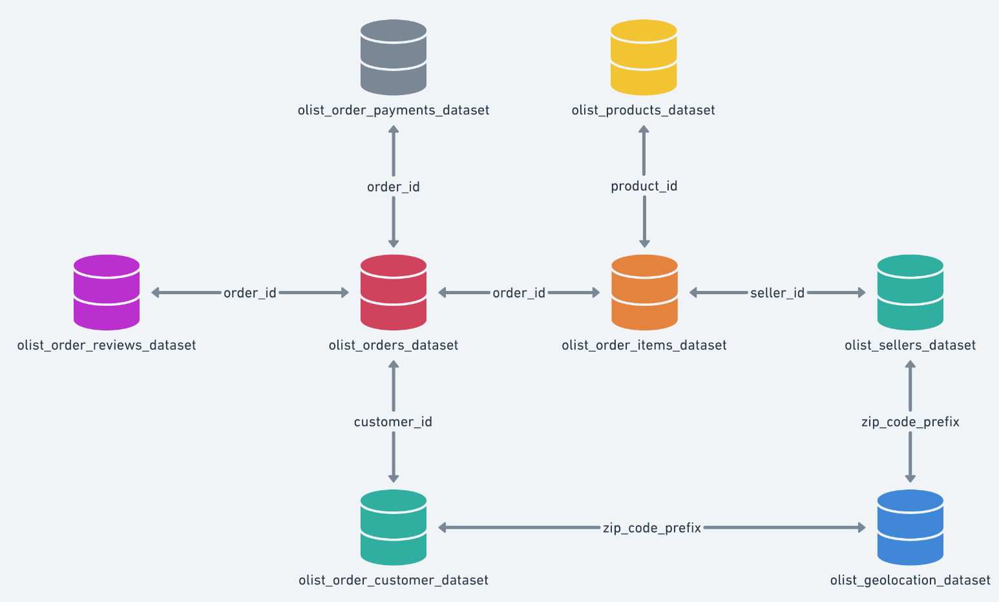

## Datasets clients et geolocalisation

### Dataset clients

In [3]:
clients_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


In [4]:
clients_data.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [5]:
clients_data.shape

(99441, 5)

In [6]:
clients_data.describe()

,customer_zip_code_prefix
count,99441.000000
mean,35137.474583
std,29797.938996
min,1003.000000
25%,11347.000000
50%,24416.000000
75%,58900.000000
max,99990.000000


In [7]:
clients_data.isnull().sum()

customer_id                 0
customer_unique_id          0
customer_zip_code_prefix    0
customer_city               0
customer_state              0
dtype: int64

### Dataset geolocalisation

In [8]:
geolocalisation_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  1000163 non-null  int64  
 1   geolocation_lat              1000163 non-null  float64
 2   geolocation_lng              1000163 non-null  float64
 3   geolocation_city             1000163 non-null  object 
 4   geolocation_state            1000163 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 38.2+ MB


In [9]:
geolocalisation_data.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [10]:
geolocalisation_data.shape

(1000163, 5)

In [11]:
geolocalisation_data.describe()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
count,1.000163e+06,1.000163e+06,1.000163e+06
mean,3.657417e+04,-2.117615e+01,-4.639054e+01
std,3.054934e+04,5.715866e+00,4.269748e+00
min,1.001000e+03,-3.660537e+01,-1.014668e+02
25%,1.107500e+04,-2.360355e+01,-4.857317e+01
50%,2.653000e+04,-2.291938e+01,-4.663788e+01
75%,6.350400e+04,-1.997962e+01,-4.376771e+01
max,9.999000e+04,4.506593e+01,1.211054e+02


In [12]:
geolocalisation_data.isnull().sum()

geolocation_zip_code_prefix    0
geolocation_lat                0
geolocation_lng                0
geolocation_city               0
geolocation_state              0
dtype: int64

### Merge des datasets 

In [13]:
clients_data = clients_data.rename(
    columns={'customer_zip_code_prefix': 'zip_code_prefix'})
geolocalisation_data = geolocalisation_data.rename(
    columns={'geolocation_zip_code_prefix': 'zip_code_prefix'})

In [14]:
geolocalisation_data = geolocalisation_data.groupby(['zip_code_prefix']).mean()

In [15]:
geolocalisation_data.reset_index()

,zip_code_prefix,geolocation_lat,geolocation_lng
0,1001,-23.550190,-46.634024
1,1002,-23.548146,-46.634979
2,1003,-23.548994,-46.635731
3,1004,-23.549799,-46.634757
4,1005,-23.549456,-46.636733
...,...,...,...
19010,99960,-27.953722,-52.025511
19011,99965,-28.183372,-52.039850
19012,99970,-28.343766,-51.874689
19013,99980,-28.389129,-51.843836


In [16]:
customers_df = pd.merge(clients_data, geolocalisation_data,
                        how='left', on='zip_code_prefix')

In [17]:
customers_df.head()

,customer_id,customer_unique_id,zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.498489,-47.396929
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,-23.727992,-46.542848
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,-23.531642,-46.656289
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,-23.499702,-46.185233
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,-22.975100,-47.142925


In [18]:
customers_df.shape

(99441, 7)

In [19]:
customers_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99441 entries, 0 to 99440
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   customer_id         99441 non-null  object 
 1   customer_unique_id  99441 non-null  object 
 2   zip_code_prefix     99441 non-null  int64  
 3   customer_city       99441 non-null  object 
 4   customer_state      99441 non-null  object 
 5   geolocation_lat     99163 non-null  float64
 6   geolocation_lng     99163 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 6.1+ MB


## Datasets commandes, payments et reviews

###  Datasets commandes

In [20]:
order_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


In [21]:
order_data.describe()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
count,99441,99441,99441,99441,99281,97658,96476,99441
unique,99441,99441,8,98875,90733,81018,95664,459
top,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2018-04-11 10:48:14,2018-02-27 04:31:10,2018-05-09 15:48:00,2018-05-08 23:38:46,2017-12-20 00:00:00
freq,1,1,96478,3,9,47,3,522


In [22]:
order_data.isnull().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64

In [23]:
order_data['order_delivered_customer_date'].fillna(
    order_data['order_estimated_delivery_date'], inplace=True)

In [24]:
order_data.drop(['order_approved_at', 'order_delivered_carrier_date',
                'order_estimated_delivery_date'], axis=1, inplace=True)

In [25]:
order_data.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-08-07 15:27:45
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-17 18:06:29
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-12-02 00:28:42
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-16 18:17:02


In [26]:
order_data.isnull().sum()

order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_delivered_customer_date    0
dtype: int64

In [27]:
order_data['order_status'].value_counts()

delivered      96478
shipped         1107
canceled         625
unavailable      609
invoiced         314
processing       301
created            5
approved           2
Name: order_status, dtype: int64

In [28]:
order_data = order_data[order_data['order_status'] == 'delivered']

In [29]:
order_data.shape

(96478, 5)

In [30]:
customers_df = pd.merge(customers_df, order_data,
                        how='inner', on='customer_id')

In [31]:
customers_df.head()

,customer_id,customer_unique_id,zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.498489,-47.396929,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-25 10:35:35
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,-23.727992,-46.542848,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-29 12:41:19
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,-23.531642,-46.656289,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-06-14 17:58:51
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,-23.499702,-46.185233,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-28 16:04:25
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,-22.975100,-47.142925,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-08-09 20:55:48


In [32]:
customers_df.shape

(96478, 11)

In [33]:
customers_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96478 entries, 0 to 96477
Data columns (total 11 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   customer_id                    96478 non-null  object 
 1   customer_unique_id             96478 non-null  object 
 2   zip_code_prefix                96478 non-null  int64  
 3   customer_city                  96478 non-null  object 
 4   customer_state                 96478 non-null  object 
 5   geolocation_lat                96214 non-null  float64
 6   geolocation_lng                96214 non-null  float64
 7   order_id                       96478 non-null  object 
 8   order_status                   96478 non-null  object 
 9   order_purchase_timestamp       96478 non-null  object 
 10  order_delivered_customer_date  96478 non-null  object 
dtypes: float64(2), int64(1), object(8)
memory usage: 8.8+ MB


### Dataset items

In [34]:
order_items_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   order_id             112650 non-null  object 
 1   order_item_id        112650 non-null  int64  
 2   product_id           112650 non-null  object 
 3   seller_id            112650 non-null  object 
 4   shipping_limit_date  112650 non-null  object 
 5   price                112650 non-null  float64
 6   freight_value        112650 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 6.0+ MB


In [35]:
order_items_data.describe()

,order_item_id,price,freight_value
count,112650.000000,112650.000000,112650.000000
mean,1.197834,120.653739,19.990320
std,0.705124,183.633928,15.806405
min,1.000000,0.850000,0.000000
25%,1.000000,39.900000,13.080000
50%,1.000000,74.990000,16.260000
75%,1.000000,134.900000,21.150000
max,21.000000,6735.000000,409.680000


In [36]:
order_items_data.isnull().sum()

order_id               0
order_item_id          0
product_id             0
seller_id              0
shipping_limit_date    0
price                  0
freight_value          0
dtype: int64

In [37]:
order_items_data.drop(
    ['shipping_limit_date', 'seller_id'], axis=1, inplace=True)

In [38]:
order_items_data.head()

,order_id,order_item_id,product_id,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,199.90,18.14


In [39]:
order_items_data.shape

(112650, 5)

In [40]:
customers_df = pd.merge(customers_df, order_items_data,
                        how='inner', on='order_id')

In [41]:
customers_df.shape

(110197, 15)

In [42]:
customers_df.head()

,customer_id,customer_unique_id,zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,price,freight_value
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.498489,-47.396929,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-25 10:35:35,1,a9516a079e37a9c9c36b9b78b10169e8,124.99,21.88
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,-23.727992,-46.542848,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-29 12:41:19,1,4aa6014eceb682077f9dc4bffebc05b0,289.00,46.48
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,-23.531642,-46.656289,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-06-14 17:58:51,1,bd07b66896d6f1494f5b86251848ced7,139.94,17.79
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,-23.499702,-46.185233,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-28 16:04:25,1,a5647c44af977b148e0a3a4751a09e2e,149.94,23.36
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,-22.975100,-47.142925,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-08-09 20:55:48,1,9391a573abe00141c56e38d84d7d5b3b,230.00,22.25


In [43]:
customers_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110197 entries, 0 to 110196
Data columns (total 15 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_id                    110197 non-null  object 
 1   customer_unique_id             110197 non-null  object 
 2   zip_code_prefix                110197 non-null  int64  
 3   customer_city                  110197 non-null  object 
 4   customer_state                 110197 non-null  object 
 5   geolocation_lat                109909 non-null  float64
 6   geolocation_lng                109909 non-null  float64
 7   order_id                       110197 non-null  object 
 8   order_status                   110197 non-null  object 
 9   order_purchase_timestamp       110197 non-null  object 
 10  order_delivered_customer_date  110197 non-null  object 
 11  order_item_id                  110197 non-null  int64  
 12  product_id                    

### Dataset payment

In [44]:
order_payment_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103886 non-null  object 
 1   payment_sequential    103886 non-null  int64  
 2   payment_type          103886 non-null  object 
 3   payment_installments  103886 non-null  int64  
 4   payment_value         103886 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 4.0+ MB


In [45]:
order_payment_data.describe()

,payment_sequential,payment_installments,payment_value
count,103886.000000,103886.000000,103886.000000
mean,1.092679,2.853349,154.100380
std,0.706584,2.687051,217.494064
min,1.000000,0.000000,0.000000
25%,1.000000,1.000000,56.790000
50%,1.000000,1.000000,100.000000
75%,1.000000,4.000000,171.837500
max,29.000000,24.000000,13664.080000


In [46]:
order_payment_data.isnull().sum()

order_id                0
payment_sequential      0
payment_type            0
payment_installments    0
payment_value           0
dtype: int64

In [47]:
order_payment_data[order_payment_data['payment_installments'] == 0]

,order_id,payment_sequential,payment_type,payment_installments,payment_value
46982,744bade1fcf9ff3f31d860ace076d422,2,credit_card,0,58.69
79014,1a57108394169c0b47d8f876acc9ba2d,2,credit_card,0,129.94


In [48]:
idx = order_payment_data.index[order_payment_data['payment_installments'] == 0]
print(idx)

Int64Index([46982, 79014], dtype='int64')


In [49]:
order_payment_data.loc[idx, 'payment_installments'] = 1

In [50]:
order_payment_data.describe()

,payment_sequential,payment_installments,payment_value
count,103886.000000,103886.000000,103886.000000
mean,1.092679,2.853368,154.100380
std,0.706584,2.687034,217.494064
min,1.000000,1.000000,0.000000
25%,1.000000,1.000000,56.790000
50%,1.000000,1.000000,100.000000
75%,1.000000,4.000000,171.837500
max,29.000000,24.000000,13664.080000


In [51]:
order_payment_data.shape

(103886, 5)

In [52]:
order_payment_data[order_payment_data['order_id']
                   == '0016dfedd97fc2950e388d2971d718c7']

,order_id,payment_sequential,payment_type,payment_installments,payment_value
80856,0016dfedd97fc2950e388d2971d718c7,2,voucher,1,17.92
89575,0016dfedd97fc2950e388d2971d718c7,1,credit_card,5,52.63


In [53]:
order_payment_data = order_payment_data.groupby(["order_id"])\
    .agg({"payment_sequential": "max",
          "payment_type": lambda x: x.values[0],
          "payment_installments": "sum",
          "payment_value": "sum"
          }).reset_index()

In [54]:
order_payment_data[order_payment_data['order_id']
                   == '0016dfedd97fc2950e388d2971d718c7']

,order_id,payment_sequential,payment_type,payment_installments,payment_value
36,0016dfedd97fc2950e388d2971d718c7,2,voucher,6,70.55


In [55]:
order_payment_data.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,credit_card,2,72.19
1,00018f77f2f0320c557190d7a144bdd3,1,credit_card,3,259.83
2,000229ec398224ef6ca0657da4fc703e,1,credit_card,5,216.87
3,00024acbcdf0a6daa1e931b038114c75,1,credit_card,2,25.78
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,credit_card,3,218.04


In [56]:
customers_df = pd.merge(customers_df, order_payment_data,
                        how='left', on='order_id')

In [57]:
customers_df.shape

(110197, 19)

In [58]:
customers_df.describe()

,zip_code_prefix,geolocation_lat,geolocation_lng,order_item_id,price,freight_value,payment_sequential,payment_installments,payment_value
count,110197.000000,109909.000000,109909.000000,110197.000000,110197.000000,110197.000000,110194.000000,110194.000000,110194.000000
mean,35155.346888,-21.246399,-46.216011,1.198181,119.980563,19.948598,1.044730,3.065748,179.466763
std,29901.148745,5.558492,4.034165,0.706676,182.299446,15.698136,0.377636,2.828194,271.338343
min,1003.000000,-33.689948,-72.668881,1.000000,0.850000,0.000000,1.000000,1.000000,9.590000
25%,11310.000000,-23.592368,-48.125102,1.000000,39.900000,13.080000,1.000000,1.000000,65.600000
50%,24344.000000,-22.929564,-46.634985,1.000000,74.900000,16.260000,1.000000,2.000000,114.345000
75%,59066.000000,-20.182732,-43.667690,1.000000,134.170000,21.150000,1.000000,4.000000,194.960000
max,99980.000000,42.184003,-8.723762,21.000000,6735.000000,409.680000,26.000000,26.000000,13664.080000


In [59]:
customers_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110197 entries, 0 to 110196
Data columns (total 19 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_id                    110197 non-null  object 
 1   customer_unique_id             110197 non-null  object 
 2   zip_code_prefix                110197 non-null  int64  
 3   customer_city                  110197 non-null  object 
 4   customer_state                 110197 non-null  object 
 5   geolocation_lat                109909 non-null  float64
 6   geolocation_lng                109909 non-null  float64
 7   order_id                       110197 non-null  object 
 8   order_status                   110197 non-null  object 
 9   order_purchase_timestamp       110197 non-null  object 
 10  order_delivered_customer_date  110197 non-null  object 
 11  order_item_id                  110197 non-null  int64  
 12  product_id                    

### Dataset reviews 

In [60]:
order_reviews_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   review_id                99224 non-null  object
 1   order_id                 99224 non-null  object
 2   review_score             99224 non-null  int64 
 3   review_comment_title     11568 non-null  object
 4   review_comment_message   40977 non-null  object
 5   review_creation_date     99224 non-null  object
 6   review_answer_timestamp  99224 non-null  object
dtypes: int64(1), object(6)
memory usage: 5.3+ MB


In [61]:
order_reviews_data.describe()

,review_score
count,99224.000000
mean,4.086421
std,1.347579
min,1.000000
25%,4.000000
50%,5.000000
75%,5.000000
max,5.000000


In [62]:
order_reviews_data.isnull().sum()

review_id                      0
order_id                       0
review_score                   0
review_comment_title       87656
review_comment_message     58247
review_creation_date           0
review_answer_timestamp        0
dtype: int64

In [63]:
order_reviews_data.drop(['review_comment_title', 'review_comment_message',
                        'review_creation_date', 'review_answer_timestamp'], axis=1, inplace=True)

In [64]:
order_reviews_data.head()

,review_id,order_id,review_score
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5


In [65]:
order_reviews_data.drop(['review_id'], axis=1, inplace=True)

In [66]:
order_reviews_data.drop_duplicates(subset=['order_id'], inplace=True)

In [67]:
order_reviews_data.head()

,order_id,review_score
0,73fc7af87114b39712e6da79b0a377eb,4
1,a548910a1c6147796b98fdf73dbeba33,5
2,f9e4b658b201a9f2ecdecbb34bed034b,5
3,658677c97b385a9be170737859d3511b,5
4,8e6bfb81e283fa7e4f11123a3fb894f1,5


In [68]:
order_reviews_data.shape

(98673, 2)

In [69]:
customers_df = pd.merge(customers_df, order_reviews_data,
                        how='left', on='order_id')

In [70]:
customers_df.shape

(110197, 20)

In [71]:
customers_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110197 entries, 0 to 110196
Data columns (total 20 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_id                    110197 non-null  object 
 1   customer_unique_id             110197 non-null  object 
 2   zip_code_prefix                110197 non-null  int64  
 3   customer_city                  110197 non-null  object 
 4   customer_state                 110197 non-null  object 
 5   geolocation_lat                109909 non-null  float64
 6   geolocation_lng                109909 non-null  float64
 7   order_id                       110197 non-null  object 
 8   order_status                   110197 non-null  object 
 9   order_purchase_timestamp       110197 non-null  object 
 10  order_delivered_customer_date  110197 non-null  object 
 11  order_item_id                  110197 non-null  int64  
 12  product_id                    

### Datasets product et products_category_name_translation

In [72]:
products_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  float64
 3   product_description_lenght  32341 non-null  float64
 4   product_photos_qty          32341 non-null  float64
 5   product_weight_g            32949 non-null  float64
 6   product_length_cm           32949 non-null  float64
 7   product_height_cm           32949 non-null  float64
 8   product_width_cm            32949 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


In [73]:
products_data.describe()

,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
count,32341.000000,32341.000000,32341.000000,32949.000000,32949.000000,32949.000000,32949.000000
mean,48.476949,771.495285,2.188986,2276.472488,30.815078,16.937661,23.196728
std,10.245741,635.115225,1.736766,4282.038731,16.914458,13.637554,12.079047
min,5.000000,4.000000,1.000000,0.000000,7.000000,2.000000,6.000000
25%,42.000000,339.000000,1.000000,300.000000,18.000000,8.000000,15.000000
50%,51.000000,595.000000,1.000000,700.000000,25.000000,13.000000,20.000000
75%,57.000000,972.000000,3.000000,1900.000000,38.000000,21.000000,30.000000
max,76.000000,3992.000000,20.000000,40425.000000,105.000000,105.000000,118.000000


In [74]:
products_data.isnull().sum()

product_id                      0
product_category_name         610
product_name_lenght           610
product_description_lenght    610
product_photos_qty            610
product_weight_g                2
product_length_cm               2
product_height_cm               2
product_width_cm                2
dtype: int64

In [75]:
products_data.drop(['product_name_lenght', 'product_description_lenght', 'product_weight_g',
                   'product_length_cm', 'product_height_cm', 'product_width_cm'], axis=1, inplace=True)

In [76]:
products_data.dropna(axis=0, inplace=True)

In [77]:
products_data.isnull().sum()

product_id               0
product_category_name    0
product_photos_qty       0
dtype: int64

In [78]:
products_category_transl_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 2 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   product_category_name          71 non-null     object
 1   product_category_name_english  71 non-null     object
dtypes: object(2)
memory usage: 1.2+ KB


In [79]:
products_category_transl_data['product_category_name_english'].unique()

array(['health_beauty', 'computers_accessories', 'auto', 'bed_bath_table',
       'furniture_decor', 'sports_leisure', 'perfumery', 'housewares',
       'telephony', 'watches_gifts', 'food_drink', 'baby', 'stationery',
       'tablets_printing_image', 'toys', 'fixed_telephony',
       'garden_tools', 'fashion_bags_accessories', 'small_appliances',
       'consoles_games', 'audio', 'fashion_shoes', 'cool_stuff',
       'luggage_accessories', 'air_conditioning',
       'construction_tools_construction',
       'kitchen_dining_laundry_garden_furniture',
       'costruction_tools_garden', 'fashion_male_clothing', 'pet_shop',
       'office_furniture', 'market_place', 'electronics',
       'home_appliances', 'party_supplies', 'home_confort',
       'costruction_tools_tools', 'agro_industry_and_commerce',
       'furniture_mattress_and_upholstery', 'books_technical',
       'home_construction', 'musical_instruments',
       'furniture_living_room', 'construction_tools_lights',
       'indust

In [80]:
products_category_transl_data[products_category_transl_data['product_category_name_english'] == 'housewares']

,product_category_name,product_category_name_english
7,utilidades_domesticas,housewares


In [81]:
products_category_transl_data[products_category_transl_data['product_category_name_english'] == 'computers']

,product_category_name,product_category_name_english
53,pcs,computers


In [82]:
products_data[~products_data['product_category_name'].isin(
    products_category_transl_data['product_category_name'])]['product_category_name'].unique()

array(['pc_gamer', 'portateis_cozinha_e_preparadores_de_alimentos'],
      dtype=object)

In [83]:
products_data['product_category_name'].replace('pc_gamer', 'pcs', inplace=True)
products_data['product_category_name'].replace(
    'portateis_cozinha_e_preparadores_de_alimentos', 'utilidades_domesticas', inplace=True)

In [84]:
products_data.describe()

,product_photos_qty
count,32341.000000
mean,2.188986
std,1.736766
min,1.000000
25%,1.000000
50%,1.000000
75%,3.000000
max,20.000000


In [85]:
products_df = pd.merge(products_data, products_category_transl_data,
                       how='left', on='product_category_name')

In [86]:
products_df.drop(['product_category_name'], axis=1, inplace=True)

In [87]:
products_df.head()

,product_id,product_photos_qty,product_category_name_english
0,1e9e8ef04dbcff4541ed26657ea517e5,1.0,perfumery
1,3aa071139cb16b67ca9e5dea641aaa2f,1.0,art
2,96bd76ec8810374ed1b65e291975717f,1.0,sports_leisure
3,cef67bcfe19066a932b7673e239eb23d,1.0,baby
4,9dc1a7de274444849c219cff195d0b71,4.0,housewares


In [88]:
products_df.shape

(32341, 3)

In [89]:
customers_df = pd.merge(customers_df, products_df, how='left', on='product_id')

In [90]:
customers_df.shape

(110197, 22)

# Analyse univariée

In [91]:
customers_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110197 entries, 0 to 110196
Data columns (total 22 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_id                    110197 non-null  object 
 1   customer_unique_id             110197 non-null  object 
 2   zip_code_prefix                110197 non-null  int64  
 3   customer_city                  110197 non-null  object 
 4   customer_state                 110197 non-null  object 
 5   geolocation_lat                109909 non-null  float64
 6   geolocation_lng                109909 non-null  float64
 7   order_id                       110197 non-null  object 
 8   order_status                   110197 non-null  object 
 9   order_purchase_timestamp       110197 non-null  object 
 10  order_delivered_customer_date  110197 non-null  object 
 11  order_item_id                  110197 non-null  int64  
 12  product_id                    

In [92]:
customers_df.describe()

,zip_code_prefix,geolocation_lat,geolocation_lng,order_item_id,price,freight_value,payment_sequential,payment_installments,payment_value,review_score,product_photos_qty
count,110197.000000,109909.000000,109909.000000,110197.000000,110197.000000,110197.000000,110194.000000,110194.000000,110194.000000,109370.000000,108660.000000
mean,35155.346888,-21.246399,-46.216011,1.198181,119.980563,19.948598,1.044730,3.065748,179.466763,4.082481,2.210712
std,29901.148745,5.558492,4.034165,0.706676,182.299446,15.698136,0.377636,2.828194,271.338343,1.346718,1.721751
min,1003.000000,-33.689948,-72.668881,1.000000,0.850000,0.000000,1.000000,1.000000,9.590000,1.000000,1.000000
25%,11310.000000,-23.592368,-48.125102,1.000000,39.900000,13.080000,1.000000,1.000000,65.600000,4.000000,1.000000
50%,24344.000000,-22.929564,-46.634985,1.000000,74.900000,16.260000,1.000000,2.000000,114.345000,5.000000,1.000000
75%,59066.000000,-20.182732,-43.667690,1.000000,134.170000,21.150000,1.000000,4.000000,194.960000,5.000000,3.000000
max,99980.000000,42.184003,-8.723762,21.000000,6735.000000,409.680000,26.000000,26.000000,13664.080000,5.000000,20.000000


In [93]:
customers_df.head()

,customer_id,customer_unique_id,zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_score,product_photos_qty,product_category_name_english
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.498489,-47.396929,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-25 10:35:35,1,a9516a079e37a9c9c36b9b78b10169e8,124.99,21.88,1.0,credit_card,2.0,146.87,4.0,1.0,office_furniture
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,-23.727992,-46.542848,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-29 12:41:19,1,4aa6014eceb682077f9dc4bffebc05b0,289.00,46.48,1.0,credit_card,8.0,335.48,5.0,3.0,housewares
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,-23.531642,-46.656289,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-06-14 17:58:51,1,bd07b66896d6f1494f5b86251848ced7,139.94,17.79,1.0,credit_card,7.0,157.73,5.0,1.0,office_furniture
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,-23.499702,-46.185233,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-28 16:04:25,1,a5647c44af977b148e0a3a4751a09e2e,149.94,23.36,1.0,credit_card,1.0,173.30,5.0,1.0,office_furniture
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,-22.975100,-47.142925,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-08-09 20:55:48,1,9391a573abe00141c56e38d84d7d5b3b,230.00,22.25,1.0,credit_card,8.0,252.25,5.0,1.0,home_confort


## Variables quantitatives: 'price', 'freight_value' et 'payment_value'

In [94]:
customer_price_df = customers_df[['customer_unique_id', 'price', 'freight_value', 'payment_value']].groupby(
    ['customer_unique_id']).sum()
customer_price_df = customer_price_df.reset_index()
customer_price_df

,customer_unique_id,price,freight_value,payment_value
0,0000366f3b9a7992bf8c76cfdf3221e2,129.90,12.00,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,18.90,8.29,27.19
2,0000f46a3911fa3c0805444483337064,69.00,17.22,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,25.99,17.63,43.62
4,0004aac84e0df4da2b147fca70cf8255,180.00,16.89,196.89
...,...,...,...,...
93353,fffcf5a5ff07b0908bd4e2dbc735a684,1570.00,497.42,4134.84
93354,fffea47cd6d3cc0a88bd621562a9d061,64.89,19.69,84.58
93355,ffff371b4d645b6ecea244b27531430a,89.90,22.56,112.46
93356,ffff5962728ec6157033ef9805bacc48,115.00,18.69,133.69


In [95]:
customers_df[customers_df['customer_unique_id'] ==
             'fffcf5a5ff07b0908bd4e2dbc735a684']['price']

98805    890.0
98806    680.0
Name: price, dtype: float64

,count,missing values,min,max,range,mean,median,stdev,skewness,kurtosis
0,93358,0,0.850000,13440.000000,13439.100000,141.600000,89.730000,"[-74.1, 357.3]",9.746869,265.212219


,whis_low,quant25,median,quant75,whis_high,IQR
0,-112.98125,47.65,89.73,154.7375,315.36875,107.0875


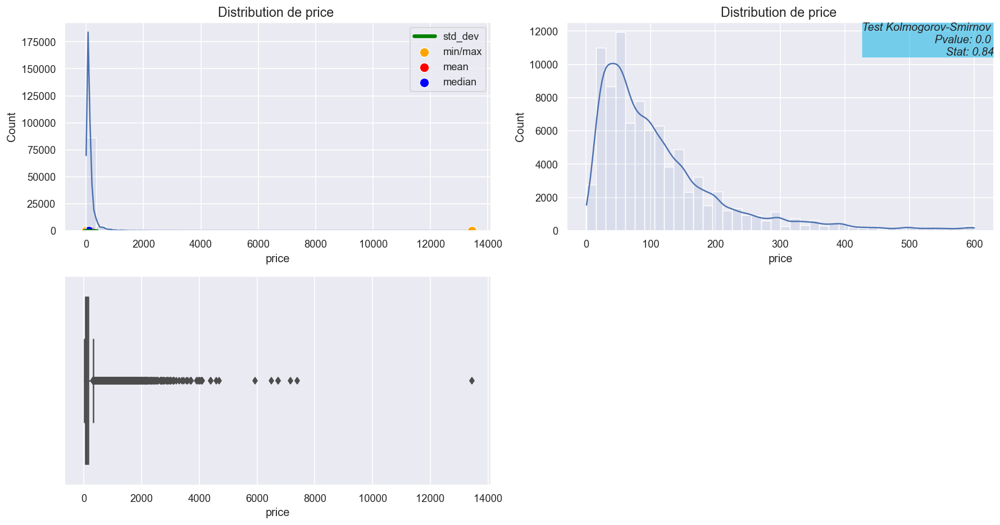

,count,missing values,min,max,range,mean,median,stdev,skewness,kurtosis
0,93358,0,0.000000,1795.000000,1795.000000,23.500000,17.600000,"[0.7, 46.3]",11.849747,519.711834


,whis_low,quant25,median,quant75,whis_high,IQR
0,-3.105,14.07,17.6,25.52,42.695,11.45


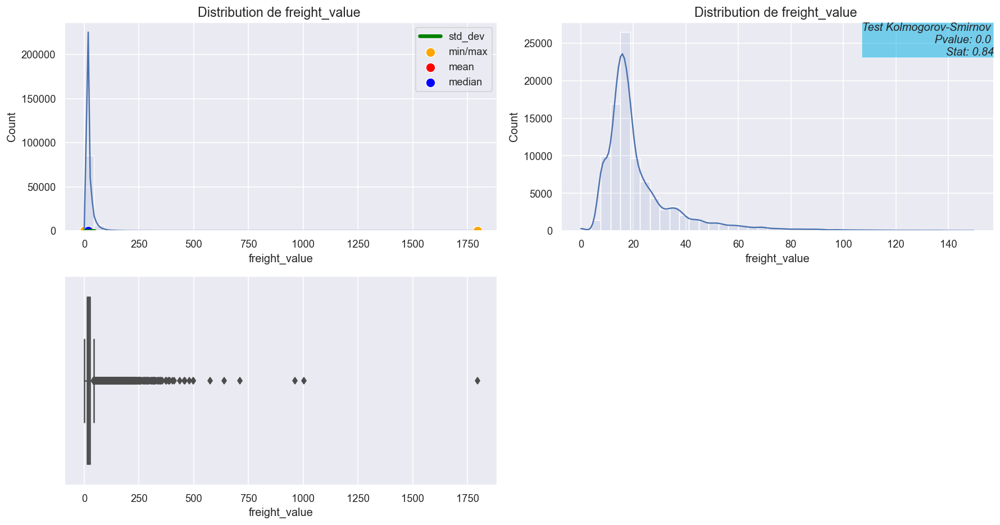

,count,missing values,min,max,range,mean,median,stdev,skewness,kurtosis
0,93358,0,9.590000,109312.600000,109312.600000,211.800000,112.950000,"[-430.4, 854.0]",70.336527,9785.107388


,whis_low,quant25,median,quant75,whis_high,IQR
0,-143.21,63.76,112.95,201.74,408.71,137.98


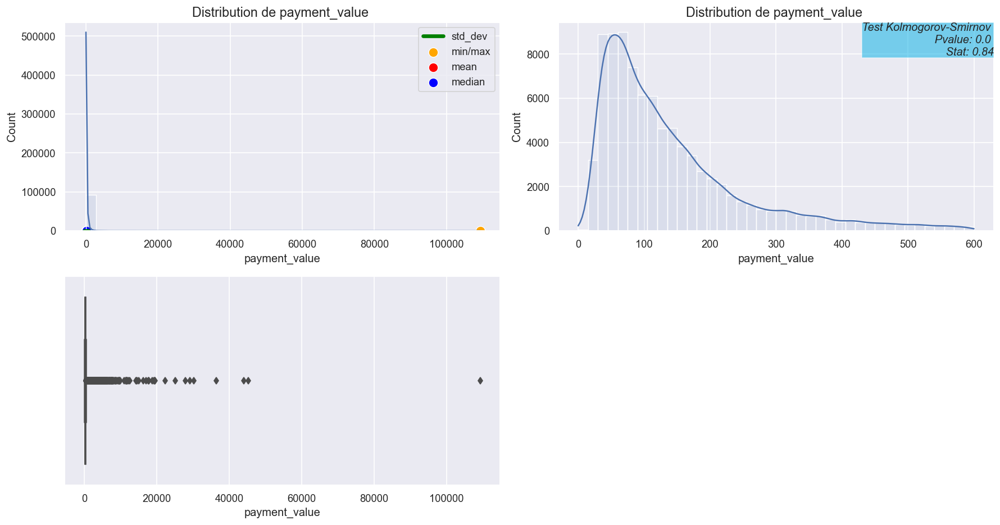

In [96]:
def Univar_Analysis(var, lim=None, pos=1):
    count = round(customer_price_df[var].shape[0], 0)
    miss = round(customer_price_df[var].isna().sum(), 0)
    mini = customers_df[var].min()
    maxi = round(customer_price_df[var].max(), 1)
    ran = round(customer_price_df[var].max()-customer_price_df[var].min(), 1)
    mean = round(customer_price_df[var].mean(), 1)
    median = customer_price_df[var].median()
    st_dev = customer_price_df[var].std()
    int_std = [round(mean-st_dev, 1), round(mean+st_dev, 1)]
    skew = customer_price_df[var].skew()
    kurt = customer_price_df[var].kurtosis()
    stat = np.array([[count, miss, mini, maxi, ran, mean,
                    median, int_std, skew, kurt]], dtype=object)
    np.warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)
    param = pd.DataFrame(stat, columns=['count', 'missing values', 'min',
                         'max', 'range', 'mean', 'median', 'stdev', 'skewness', 'kurtosis'])
    param.round(2)
    param = param.style.set_caption('Variable '+var).set_table_styles(
        [{'selector': 'caption', 'props': [('color', 'red'), ('font-size', '16px')]}])
    display(param)
    sns.set()
    fig = plt.figure(figsize=[15, 15], dpi=120)
    fig.add_subplot(4, 2, 1)
    k = 40
    ax = sns.histplot(data=customer_price_df, x=var, kde=True,
                      element="bars", bins=k, alpha=0.1)
    ax.set_title("Distribution de {} ".format(var), fontsize=14)
    sns.scatterplot(x=[mini, maxi], y=[0, 0],
                    color='orange', label="min/max", s=100)
    sns.scatterplot(x=[mean], y=[0], color='red', label="mean", s=100)
    sns.lineplot(x=int_std, y=[0, 0], color='green',
                 label="std_dev", linewidth=4)
    sns.scatterplot(x=[median], y=[0], color='blue', label="median", s=100)
    quant25 = customer_price_df[var].quantile(0.25)
    quant75 = customer_price_df[var].quantile(0.75)
    IQR = quant75 - quant25
    whis_low = quant25-(1.5*IQR)
    whis_high = quant75+(1.5*IQR)
    box_plt = [whis_low, quant25, median, quant75, whis_high, IQR]
    stat_box = np.array([box_plt])
    param_box = pd.DataFrame(stat_box, columns=[
                             'whis_low', 'quant25', 'median', 'quant75', 'whis_high', 'IQR'])
    param_box.round(2)
    display(param_box)
    if lim is not None:
        fig.add_subplot(4, 2, 2)
        ax = sns.histplot(data=customer_price_df[customer_price_df[var]
                          < lim], x=var, kde=True, element="bars", bins=k, alpha=0.1)
        # test Kolmogorof-Smirnov
        kstest = stats.kstest(customer_price_df[var].notnull(), 'norm')
        ax.set_title("Distribution de {} ".format(var), fontsize=14)
        ax.text(pos, 1, 'Test Kolmogorov-Smirnov \n Pvalue: {:.2} \n Stat: {:.2}'.format(kstest.pvalue, kstest.statistic),
                horizontalalignment='right',
                verticalalignment='top',
                style='italic', transform=ax.transAxes, fontsize=12,
                bbox={'facecolor': '#00afe6', 'alpha': 0.5, 'pad': 0})
        fig.add_subplot(4, 2, 3)
        ax = sns.boxplot(x=customer_price_df[var], showfliers=True)
        plt.xlabel(var, fontsize=12)

    else:
        # test Kolmogorof-Smirnov
        kstest = stats.kstest(customer_price_df[var].notnull(), 'norm')
        ax.set_title("Distribution de {} ".format(var), fontsize=14)
        ax.text(pos, 0.5, 'Test Kolmogorov-Smirnov \n Pvalue: {:.2} \n Stat: {:.2}'.format(kstest.pvalue, kstest.statistic),
                horizontalalignment='right',
                verticalalignment='top',
                style='italic', transform=ax.transAxes, fontsize=12,
                bbox={'facecolor': '#00afe6', 'alpha': 0.7, 'pad': 0})
        fig.add_subplot(4, 2, 2)
        ax = sns.boxplot(x=customer_price_df[var], showfliers=True)

    fig.tight_layout()
    plt.show()


Univar_Analysis('price', 600)
Univar_Analysis('freight_value', 150)
Univar_Analysis('payment_value', 600)

### Courbes de Lorenz chiffre d'affaires clients et produits

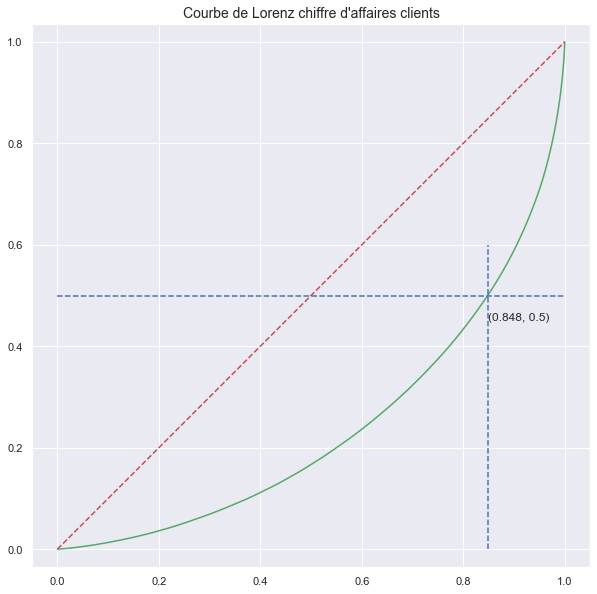

Percentage clients premium avec 50% chiffre d'affaires: 15.2 %


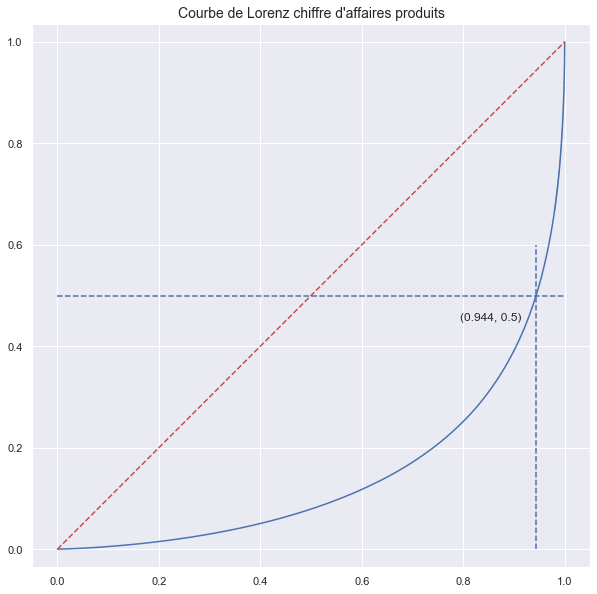

Percentage produits premium avec 50% chiffre d'affaires: 5.6 %


In [97]:
chiffre_affaire = customer_price_df['price'].values
n = len(chiffre_affaire)
lorenz_clients = np.cumsum(np.sort(chiffre_affaire)) / chiffre_affaire.sum()
lorenz_clients = np.append([0], lorenz_clients)
lorenz_clients_mediale = np.min(np.where(lorenz_clients >= 0.5))/n

fig = plt.figure(figsize=[10, 10])
plt.axes().axis('equal')
xaxis = np.linspace(0-1/n, 1+1/n, n+1)
plt.plot(xaxis, lorenz_clients, drawstyle='steps-post', color='g')
plt.plot([0, 1], [0, 1], linestyle='--', color='r')
plt.plot([0, 1], [0.5, 0.5], linestyle='--', color='b')
plt.plot([lorenz_clients_mediale, lorenz_clients_mediale],
         [0, 0.6], linestyle='--', color='b')
plt.title("Courbe de Lorenz chiffre d'affaires clients", fontsize=14)
plt.text((lorenz_clients_mediale-0.0), 0.45,
         '('+'{:.3f}'.format(lorenz_clients_mediale)+', 0.5)')
plt.show()
print("Percentage clients premium avec 50% chiffre d'affaires: {:2.1f} %".format(
    (1-lorenz_clients_mediale)*100))

produit_price_df = customers_df[['product_id', 'price']].groupby([
                                                                 'product_id']).sum()
produit_price_df = produit_price_df.reset_index()
chiffre_affaire = produit_price_df['price'].values
n = len(chiffre_affaire)
lorenz_produits = np.cumsum(np.sort(chiffre_affaire)) / chiffre_affaire.sum()
lorenz_produits = np.append([0], lorenz_produits)
lorenz_produits_mediale = np.min(np.where(lorenz_produits >= 0.5))/n

fig = plt.figure(figsize=[10, 10])
plt.axes().axis('equal')
xaxis = np.linspace(0-1/n, 1+1/n, n+1)
plt.plot(xaxis, lorenz_produits, drawstyle='steps-post')
plt.plot([0, 1], [0, 1], linestyle='--', color='r')
plt.plot([0, 1], [0.5, 0.5], linestyle='--', color='b')
plt.plot([lorenz_produits_mediale, lorenz_produits_mediale],
         [0, 0.6], linestyle='--', color='b')
plt.title("Courbe de Lorenz chiffre d'affaires produits", fontsize=14)
plt.text((lorenz_produits_mediale-0.15), 0.45,
         '('+'{:.3f}'.format(lorenz_produits_mediale)+', 0.5)')
plt.show()
print("Percentage produits premium avec 50% chiffre d'affaires: {:2.1f} %".format(
    (1-lorenz_produits_mediale)*100))

## Variables localisation 

In [98]:
customers_cnt_df = customers_df.drop_duplicates(subset=['customer_unique_id'])
customers_state_cnt_df = customers_cnt_df.groupby(
    ['customer_state'])['customer_unique_id'].count()
customers_city_cnt_df = customers_cnt_df.groupby(
    ['customer_city'])['customer_unique_id'].count()

In [99]:
print('Pays avec Ventes:', customers_state_cnt_df.shape[0])
print('Ville avec Ventes:', customers_city_cnt_df.shape[0])

Pays avec Ventes: 27
Ville avec Ventes: 4084


In [100]:
customers_state_cnt_df = customers_state_cnt_df.reset_index()
customers_state_cnt_df

,customer_state,customer_unique_id
0,AC,76
1,AL,387
2,AM,140
3,AP,66
4,BA,3157
5,CE,1257
6,DF,2017
7,ES,1927
8,GO,1894
9,MA,699


Text(0.5, 1.0, 'Localisation des clients')

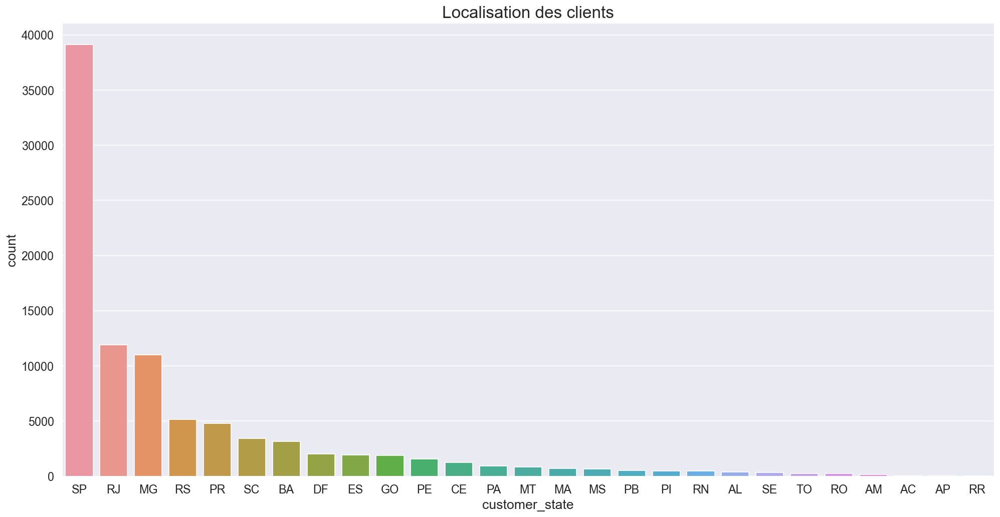

In [101]:
fig = plt.figure(figsize=[20, 10], dpi=120)
sns.barplot(x='customer_state', y='customer_unique_id',
            data=customers_state_cnt_df.sort_values('customer_unique_id', ascending=False))
plt.tick_params(axis='both', which='major', labelsize=14)
plt.xlabel('customer_state', fontsize=16)
plt.ylabel('count', fontsize=16)
plt.title('Localisation des clients', fontsize=20)

In [102]:
customers_loc_df = customers_df.groupby(['customer_unique_id']).mean()
customers_loc_df = customers_loc_df.reset_index()
customers_loc_df = customers_loc_df[['geolocation_lat', 'geolocation_lng']]
customers_loc_df.dropna(inplace=True)
customers_loc_df.isnull().sum()

geolocation_lat    0
geolocation_lng    0
dtype: int64

In [103]:
import folium
from folium import plugins
from branca.element import Figure


fig4 = Figure(height=1000, width=900)
world_map = folium.Map()
fig4.add_child(world_map)
location = customers_loc_df[['geolocation_lat', 'geolocation_lng']]

plugins.MarkerCluster(location).add_to(world_map)
world_map

## Variable produit

In [104]:
product_type_df = customers_df.drop_duplicates(subset=['order_id', 'order_item_id'])[
    ['product_id', 'order_id', 'order_item_id', 'product_category_name_english', 'price']]
product_type_df.head()

,product_id,order_id,order_item_id,product_category_name_english,price
0,a9516a079e37a9c9c36b9b78b10169e8,00e7ee1b050b8499577073aeb2a297a1,1,office_furniture,124.99
1,4aa6014eceb682077f9dc4bffebc05b0,29150127e6685892b6eab3eec79f59c7,1,housewares,289.00
2,bd07b66896d6f1494f5b86251848ced7,b2059ed67ce144a36e2aa97d2c9e9ad2,1,office_furniture,139.94
3,a5647c44af977b148e0a3a4751a09e2e,951670f92359f4fe4a63112aa7306eba,1,office_furniture,149.94
4,9391a573abe00141c56e38d84d7d5b3b,6b7d50bd145f6fc7f33cebabd7e49d0f,1,home_confort,230.00


In [105]:
product_type_df.shape

(110197, 5)

In [106]:
product_type_cnt_df = product_type_df['product_category_name_english'].value_counts(
).rename_axis('product_category_name_english').reset_index(name='counts')
product_type_cnt_df.head()

,product_category_name_english,counts
0,bed_bath_table,10953
1,health_beauty,9465
2,sports_leisure,8431
3,furniture_decor,8160
4,computers_accessories,7644


In [107]:
product_type_cnt_df.shape

(71, 2)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 [Text(0, 0, 'bed_bath_table'),
  Text(1, 0, 'health_beauty'),
  Text(2, 0, 'sports_leisure'),
  Text(3, 0, 'furniture_decor'),
  Text(4, 0, 'computers_accessories'),
  Text(5, 0, 'housewares'),
  Text(6, 0, 'watches_gifts'),
  Text(7, 0, 'telephony'),
  Text(8, 0, 'garden_tools'),
  Text(9, 0, 'auto'),
  Text(10, 0, 'toys'),
  Text(11, 0, 'cool_stuff'),
  Text(12, 0, 'perfumery'),
  Text(13, 0, 'baby'),
  Text(14, 0, 'electronics'),
  Text(15, 0, 'stationery'),
  Text(16, 0, 'fashion_bags_accessories'),
  Text(17, 0, 'pet_shop'),
  Text(18, 0, 'office_furniture'),
  Text(19, 0, 'consoles_games')])

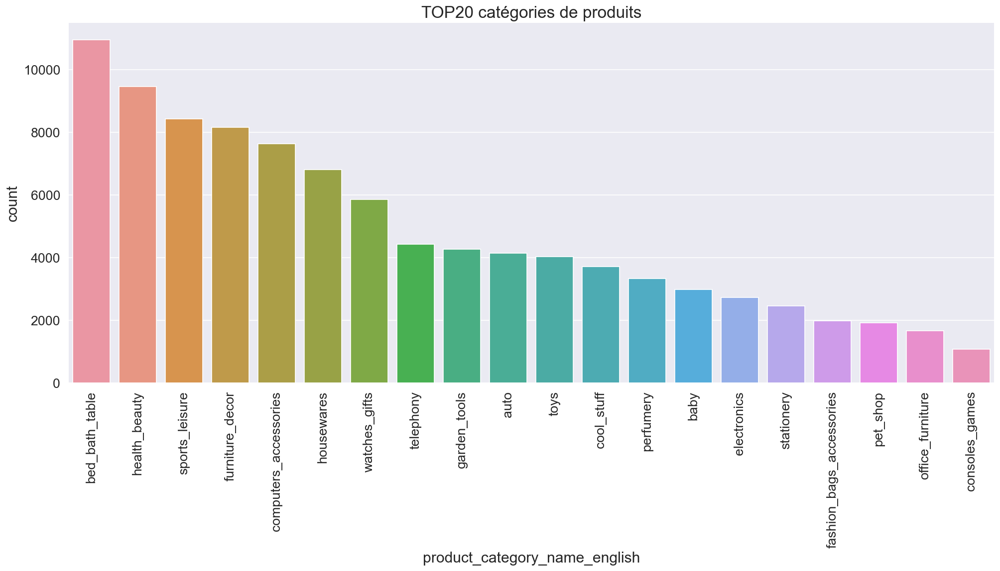

In [108]:
fig = plt.figure(figsize=[20, 8], dpi=120)
sns.barplot(x='product_category_name_english', y='counts',
            data=product_type_cnt_df.sort_values('counts', ascending=False)[:20])
plt.tick_params(axis='both', which='major', labelsize=16)
plt.xlabel('product_category_name_english', fontsize=18)
plt.ylabel('count', fontsize=18)
plt.title('TOP20 catégories de produits', fontsize=20)
plt.xticks(rotation=90)

In [109]:
produits_premium_df = customers_df.drop_duplicates(subset=['product_id'])
produits_premium_df = produits_premium_df[['product_id', 'price', 'product_category_name_english']].sort_values(
    'price', ascending=False).reset_index(drop=True)
produits_premium_df = produits_premium_df.loc[0:int(
    produits_premium_df.shape[0]/5)]
produits_premium_df.shape

(6444, 3)

In [110]:
produits_premium_df.head()

,product_id,price,product_category_name_english
0,489ae2aa008f021502940f251d4cce7f,6735.0,housewares
1,69c590f7ffc7bf8db97190b6cb6ed62e,6729.0,computers
2,1bdf5e6731585cf01aa8169c7028d6ad,6499.0,art
3,a6492cc69376c469ab6f61d8f44de961,4799.0,small_appliances
4,c3ed642d592594bb648ff4a04cee2747,4690.0,small_appliances


In [111]:
produits_premium_cnt_df = produits_premium_df['product_category_name_english'].value_counts(
).rename_axis('product_category_name_english').reset_index(name='counts')
produits_premium_cnt_df = produits_premium_cnt_df
produits_premium_cnt_df.head()

,product_category_name_english,counts
0,watches_gifts,684
1,sports_leisure,514
2,health_beauty,462
3,auto,412
4,computers_accessories,397


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 [Text(0, 0, 'watches_gifts'),
  Text(1, 0, 'sports_leisure'),
  Text(2, 0, 'health_beauty'),
  Text(3, 0, 'auto'),
  Text(4, 0, 'computers_accessories'),
  Text(5, 0, 'bed_bath_table'),
  Text(6, 0, 'furniture_decor'),
  Text(7, 0, 'cool_stuff'),
  Text(8, 0, 'toys'),
  Text(9, 0, 'housewares'),
  Text(10, 0, 'garden_tools'),
  Text(11, 0, 'perfumery'),
  Text(12, 0, 'baby'),
  Text(13, 0, 'office_furniture'),
  Text(14, 0, 'musical_instruments'),
  Text(15, 0, 'construction_tools_construction'),
  Text(16, 0, 'telephony'),
  Text(17, 0, 'pet_shop'),
  Text(18, 0, 'stationery'),
  Text(19, 0, 'small_appliances')])

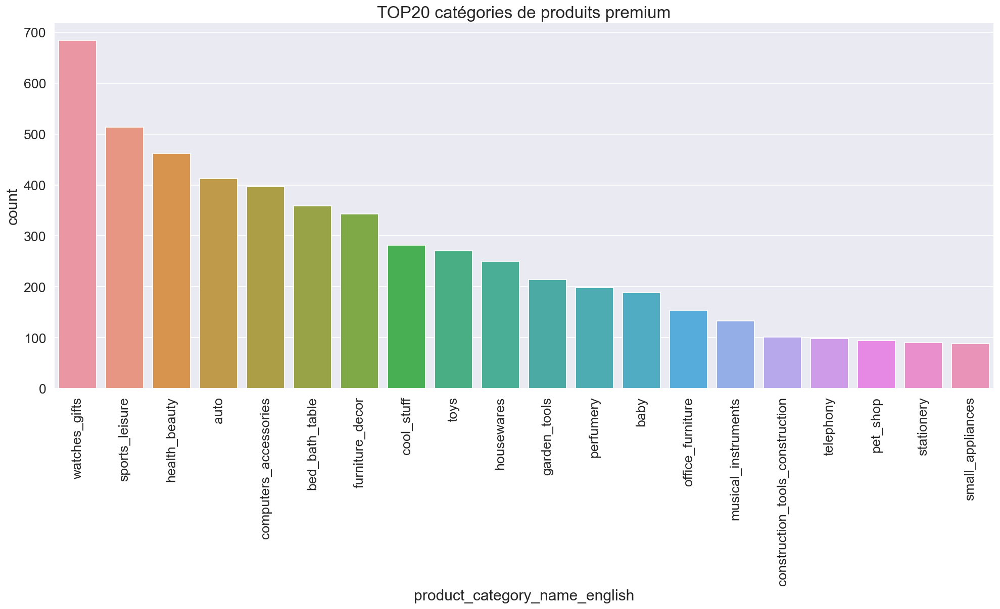

In [112]:
fig = plt.figure(figsize=[20, 8], dpi=120)
sns.barplot(x='product_category_name_english', y='counts',
            data=produits_premium_cnt_df.sort_values('counts', ascending=False)[:20])
plt.tick_params(axis='both', which='major', labelsize=16)
plt.xlabel('product_category_name_english', fontsize=18)
plt.ylabel('count', fontsize=18)
plt.title('TOP20 catégories de produits premium', fontsize=20)
plt.xticks(rotation=90)

## Variable payment_type 

1


,payment_type,customer_id,customer_unique_id,zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,price,freight_value,payment_sequential,payment_installments,payment_value,review_score,product_photos_qty,product_category_name_english
0,Not defined,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,1,1,1
1,boleto,19191,19191,19191,19191,19191,19142,19142,19191,19191,19191,19191,19191,19191,19191,19191,19191,19191,19191,19062,18931,18931
2,credit_card,73220,73220,73220,73220,73220,73016,73016,73220,73220,73220,73220,73220,73220,73220,73220,73220,73220,73220,72732,72189,72189
3,debit_card,1484,1484,1484,1484,1484,1483,1483,1484,1484,1484,1484,1484,1484,1484,1484,1484,1484,1484,1478,1458,1458
4,voucher,2582,2582,2582,2582,2582,2572,2572,2582,2582,2582,2582,2582,2582,2582,2582,2582,2582,2582,2559,2540,2540


Text(0.5, 1.0, 'Moyens de payement')

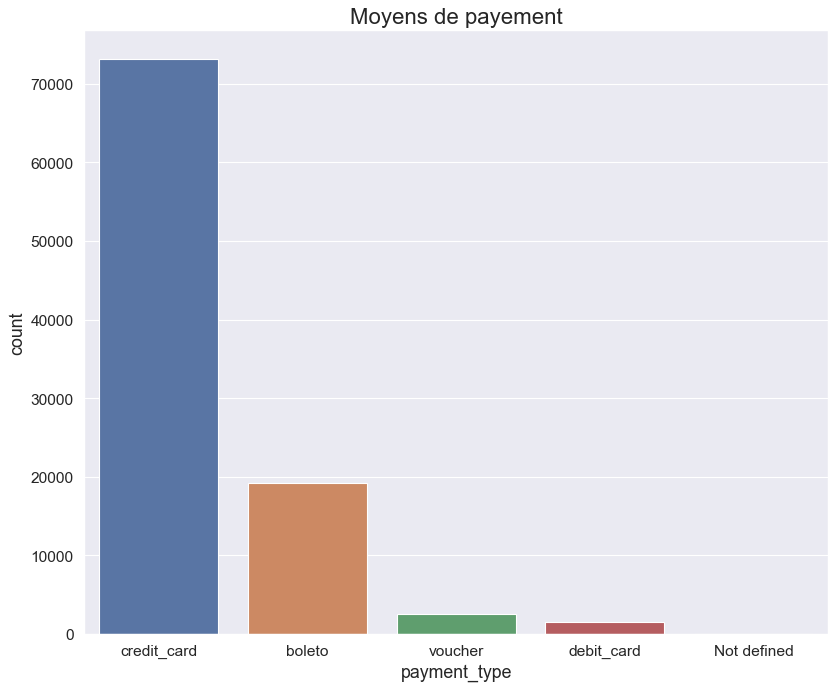

In [113]:
customer_payment_type_cnt_df = customers_df.drop_duplicates(subset=[
                                                            'order_id'])
print(customer_payment_type_cnt_df['payment_type'].isnull().sum())
customer_payment_type_cnt_df['payment_type'].fillna(
    value='Not defined', inplace=True)

customer_payment_type_cnt_df = customer_payment_type_cnt_df.groupby(
    ['payment_type']).count()
customer_payment_type_cnt_df = customer_payment_type_cnt_df.reset_index()
display(customer_payment_type_cnt_df)

fig = plt.figure(figsize=[12, 10], dpi=80)
sns.barplot(x='payment_type', y='customer_unique_id',
            data=customer_payment_type_cnt_df.sort_values('customer_unique_id', ascending=False))
plt.tick_params(axis='both', which='major', labelsize=14)
plt.xlabel('payment_type', fontsize=16)
plt.ylabel('count', fontsize=16)
plt.title('Moyens de payement', fontsize=20)

## Variable 'review_score'

In [114]:
customer_review_cnt_df = customers_df.drop_duplicates(subset=['order_id'])
customer_review_cnt_df['review_score'].fillna(
    value='Not reviewed', inplace=True)
customer_review_cnt_df = customer_review_cnt_df.groupby(
    ['review_score']).count()
customer_review_cnt_df = customer_review_cnt_df.reset_index()
display(customer_review_cnt_df[['review_score', 'customer_id']])

,review_score,customer_id
0,1.0,9344
1,2.0,2923
2,3.0,7908
3,4.0,18893
4,5.0,56764
5,Not reviewed,646


Text(0.5, 1.0, 'Evaluation des clients')

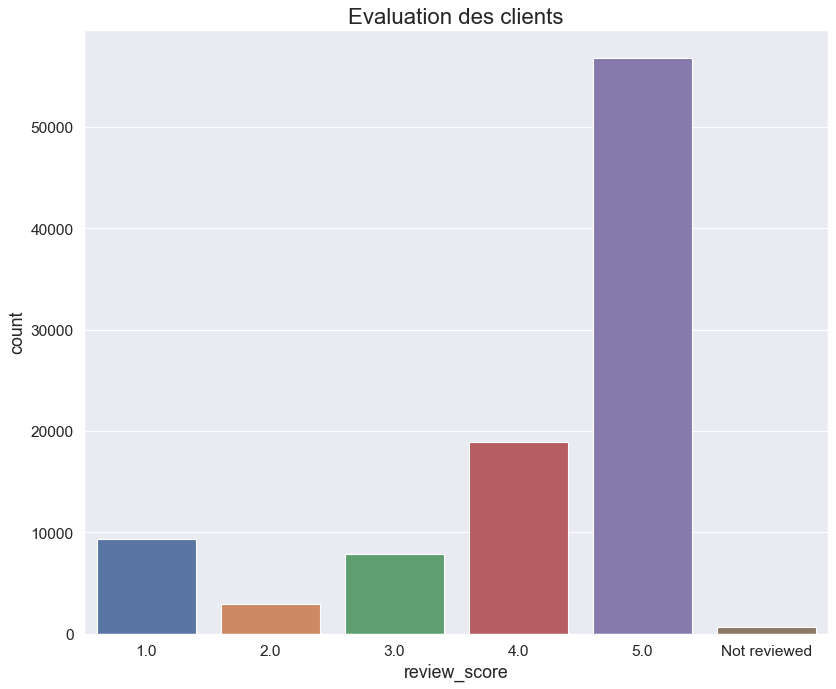

In [115]:
fig = plt.figure(figsize=[12, 10], dpi=80)
sns.barplot(x='review_score', y='customer_id', data=customer_review_cnt_df)
plt.tick_params(axis='both', which='major', labelsize=14)
plt.xlabel('review_score', fontsize=16)
plt.ylabel('count', fontsize=16)
plt.title('Evaluation des clients', fontsize=20)

## Variable payment_installements

In [116]:
idx = customers_df.index[customers_df['payment_installments'].isnull()]
print(idx)

Int64Index([23467, 23468, 23469], dtype='int64')


In [117]:
customers_df.loc[idx][:]

,customer_id,customer_unique_id,zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_score,product_photos_qty,product_category_name_english
23467,86dc2ffce2dfff336de2f386a786e574,830d5b7aaa3b6f1e9ad63703bec97d23,14600,sao joaquim da barra,SP,-20.585751,-47.863693,bfbd0f9bdef84302105ad712db648a6c,delivered,2016-09-15 12:16:38,2016-11-09 07:47:38,1,5a6b04657a4c5ee34285d1e4619a96b4,44.99,2.83,NaN,NaN,NaN,NaN,1.0,1.0,health_beauty
23468,86dc2ffce2dfff336de2f386a786e574,830d5b7aaa3b6f1e9ad63703bec97d23,14600,sao joaquim da barra,SP,-20.585751,-47.863693,bfbd0f9bdef84302105ad712db648a6c,delivered,2016-09-15 12:16:38,2016-11-09 07:47:38,2,5a6b04657a4c5ee34285d1e4619a96b4,44.99,2.83,NaN,NaN,NaN,NaN,1.0,1.0,health_beauty
23469,86dc2ffce2dfff336de2f386a786e574,830d5b7aaa3b6f1e9ad63703bec97d23,14600,sao joaquim da barra,SP,-20.585751,-47.863693,bfbd0f9bdef84302105ad712db648a6c,delivered,2016-09-15 12:16:38,2016-11-09 07:47:38,3,5a6b04657a4c5ee34285d1e4619a96b4,44.99,2.83,NaN,NaN,NaN,NaN,1.0,1.0,health_beauty


In [118]:
customers_df['payment_installments'].fillna(value=1, inplace=True)

In [119]:
customers_df.loc[idx]['payment_installments']

23467    1.0
23468    1.0
23469    1.0
Name: payment_installments, dtype: float64

In [120]:
customer_payment_installements_df = customers_df[[
    'order_id', 'payment_installments']]
customer_payment_installements_df

,order_id,payment_installments
0,00e7ee1b050b8499577073aeb2a297a1,2.0
1,29150127e6685892b6eab3eec79f59c7,8.0
2,b2059ed67ce144a36e2aa97d2c9e9ad2,7.0
3,951670f92359f4fe4a63112aa7306eba,1.0
4,6b7d50bd145f6fc7f33cebabd7e49d0f,8.0
...,...,...
110192,6760e20addcf0121e9d58f2f1ff14298,6.0
110193,9ec0c8947d973db4f4e8dcf1fbfa8f1b,3.0
110194,fed4434add09a6f332ea398efd656a5c,5.0
110195,e31ec91cea1ecf97797787471f98a8c2,2.0


In [121]:
customer_payment_installements_df = customer_payment_installements_df['payment_installments'].value_counts(
).rename_axis('payment_installments').reset_index(name='counts')
customer_payment_installements_df.payment_installments = customer_payment_installements_df.payment_installments.astype(
    int)
customer_payment_installements_df.head()

,payment_installments,counts
0,1,50600
1,2,14688
2,3,11771
3,4,7937
4,10,6553


Text(0.5, 1.0, 'Tranches de payement')

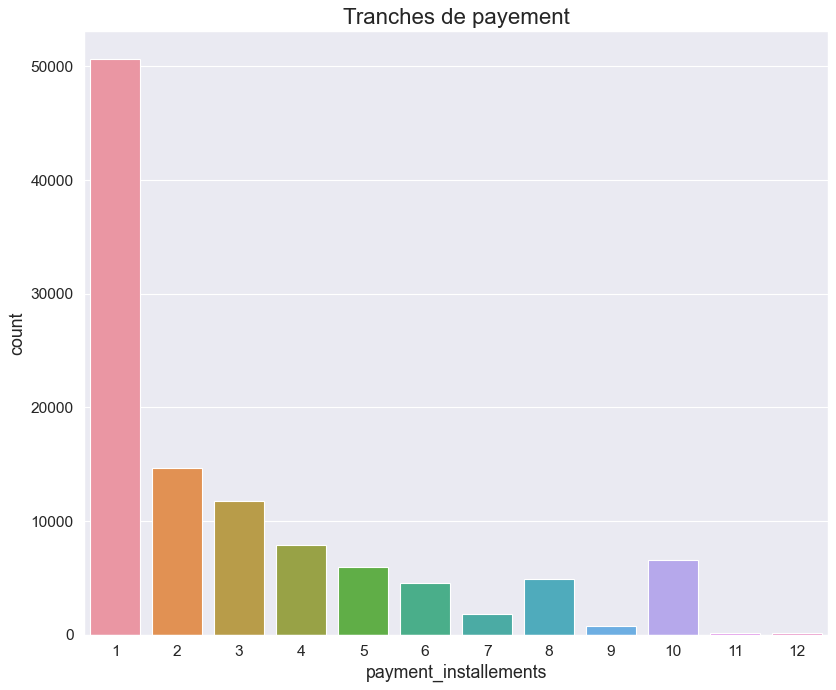

In [122]:
fig = plt.figure(figsize=[12, 10], dpi=80)
sns.barplot(x='payment_installments', y='counts',
            data=customer_payment_installements_df[:12])
plt.tick_params(axis='both', which='major', labelsize=14)
plt.xlabel('payment_installements', fontsize=16)
plt.ylabel('count', fontsize=16)
plt.title('Tranches de payement', fontsize=20)

## Variable product_photos_qty 

Text(0.5, 1.0, 'Nombre photos par produit')

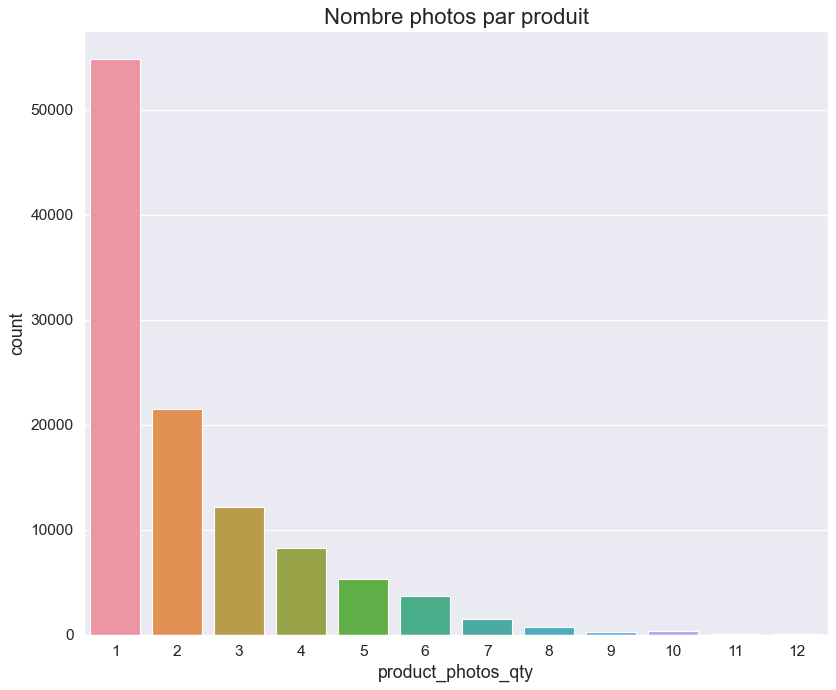

In [123]:
customer_product_photos_qty_df = customers_df[[
    'order_id', 'product_photos_qty']]
customer_product_photos_qty_df = customer_product_photos_qty_df['product_photos_qty'].value_counts(
).rename_axis('product_photos_qty').reset_index(name='counts')
customer_product_photos_qty_df.product_photos_qty = customer_product_photos_qty_df.product_photos_qty.astype(
    int)
fig = plt.figure(figsize=[12, 10], dpi=80)
sns.barplot(x='product_photos_qty', y='counts',
            data=customer_product_photos_qty_df[:12])
plt.tick_params(axis='both', which='major', labelsize=14)
plt.xlabel('product_photos_qty', fontsize=16)
plt.ylabel('count', fontsize=16)
plt.title('Nombre photos par produit', fontsize=20)

# Analise bivariée

In [124]:
customers_df.head()

,customer_id,customer_unique_id,zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_score,product_photos_qty,product_category_name_english
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.498489,-47.396929,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-25 10:35:35,1,a9516a079e37a9c9c36b9b78b10169e8,124.99,21.88,1.0,credit_card,2.0,146.87,4.0,1.0,office_furniture
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,-23.727992,-46.542848,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-29 12:41:19,1,4aa6014eceb682077f9dc4bffebc05b0,289.00,46.48,1.0,credit_card,8.0,335.48,5.0,3.0,housewares
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,-23.531642,-46.656289,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-06-14 17:58:51,1,bd07b66896d6f1494f5b86251848ced7,139.94,17.79,1.0,credit_card,7.0,157.73,5.0,1.0,office_furniture
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,-23.499702,-46.185233,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-28 16:04:25,1,a5647c44af977b148e0a3a4751a09e2e,149.94,23.36,1.0,credit_card,1.0,173.30,5.0,1.0,office_furniture
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,-22.975100,-47.142925,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-08-09 20:55:48,1,9391a573abe00141c56e38d84d7d5b3b,230.00,22.25,1.0,credit_card,8.0,252.25,5.0,1.0,home_confort


In [125]:
valeur_commande_df = customers_df.groupby(['order_id']).agg({
    "payment_value": "mean",
    "product_photos_qty": "sum"}).reset_index()
valeur_commande_df.dropna(axis=0, inplace=True)
valeur_commande_df.isnull().sum()

order_id              0
payment_value         0
product_photos_qty    0
dtype: int64

In [126]:
valeur_commande_df.head()

,order_id,payment_value,product_photos_qty
0,00010242fe8c5a6d1ba2dd792cb16214,72.19,4.0
1,00018f77f2f0320c557190d7a144bdd3,259.83,2.0
2,000229ec398224ef6ca0657da4fc703e,216.87,2.0
3,00024acbcdf0a6daa1e931b038114c75,25.78,1.0
4,00042b26cf59d7ce69dfabb4e55b4fd9,218.04,1.0


In [127]:
np.sort(valeur_commande_df['product_photos_qty'].unique())

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.,
       26., 27., 28., 30., 32., 33., 34., 36., 40., 48., 54., 60., 62.])

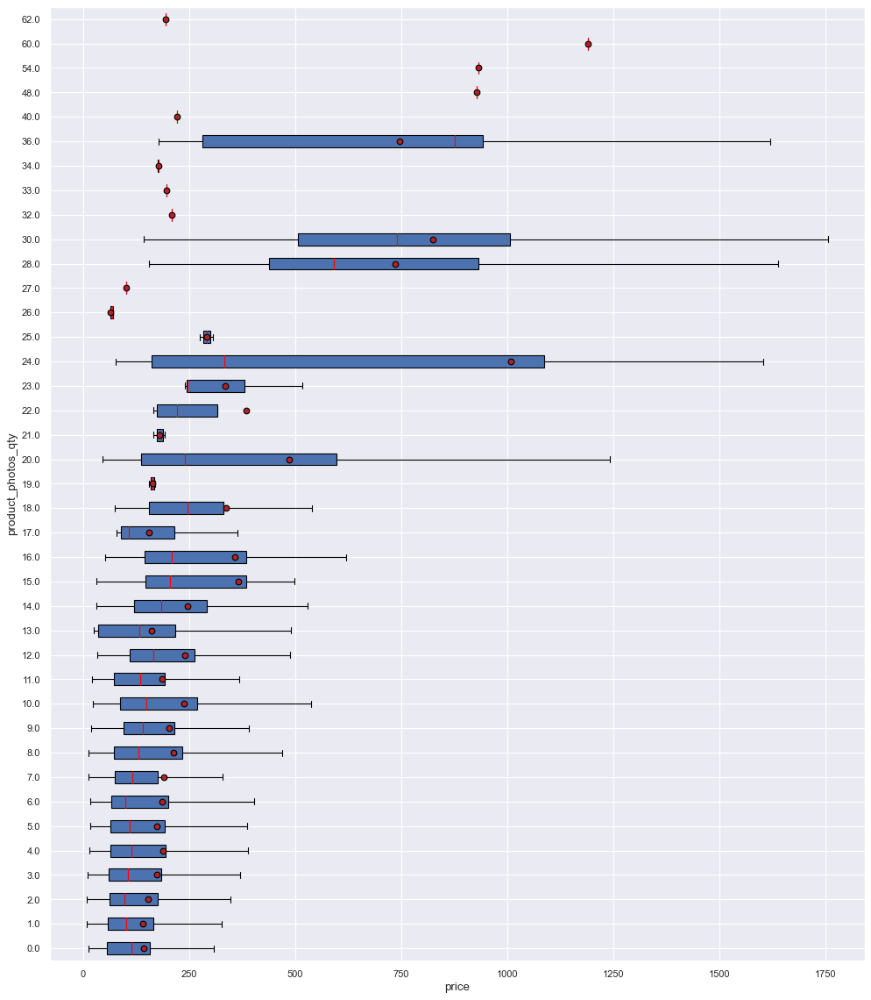

In [128]:
fig = plt.figure(figsize=[15, 18], dpi=80)
groupes = []
categories = np.sort(valeur_commande_df['product_photos_qty'].unique())
for element in categories:
    groupes.append(
        valeur_commande_df[valeur_commande_df['product_photos_qty'] == element]['payment_value'])

medianprops = {'color': "red"}
meanprops = {'marker': 'o', 'markeredgecolor': 'black',
             'markerfacecolor': 'firebrick'}
ax = plt.boxplot(groupes, labels=categories, showfliers=False, medianprops=medianprops,
                 vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)
ax = plt.xticks(fontsize=10)
ax = plt.yticks(fontsize=10)
ax = plt.xlabel('{}'.format('price'), fontdict=None, fontsize=12)
ax = plt.ylabel('product_photos_qty', fontdict=None, fontsize=12)

In [129]:
from pingouin import kruskal
print(kruskal(data=valeur_commande_df, dv='payment_value',
      between='product_photos_qty'), '\n')

                     Source  ddof1            H          p-unc
Kruskal  product_photos_qty     38  1278.360829  1.302386e-243 



# Pre-processing et Feature engineering

## Remplissage valeurs manquantes

In [130]:
customers_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110197 entries, 0 to 110196
Data columns (total 22 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_id                    110197 non-null  object 
 1   customer_unique_id             110197 non-null  object 
 2   zip_code_prefix                110197 non-null  int64  
 3   customer_city                  110197 non-null  object 
 4   customer_state                 110197 non-null  object 
 5   geolocation_lat                109909 non-null  float64
 6   geolocation_lng                109909 non-null  float64
 7   order_id                       110197 non-null  object 
 8   order_status                   110197 non-null  object 
 9   order_purchase_timestamp       110197 non-null  object 
 10  order_delivered_customer_date  110197 non-null  object 
 11  order_item_id                  110197 non-null  int64  
 12  product_id                    

In [131]:
customers_df['product_photos_qty'].fillna(value=0, inplace=True)

In [132]:
customers_df['payment_sequential'].fillna(value=1, inplace=True)
customers_df['payment_installments'].fillna(value=1, inplace=True)

In [133]:
customers_df['payment_value'].fillna(
    value=customers_df['price']+customers_df['freight_value'], inplace=True)

In [134]:
m = stats.mode(customers_df['review_score'])[0]
print(m)
customers_df['review_score'] = customers_df['review_score'].fillna(m[0])

[5.]


In [135]:
customers_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110197 entries, 0 to 110196
Data columns (total 22 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_id                    110197 non-null  object 
 1   customer_unique_id             110197 non-null  object 
 2   zip_code_prefix                110197 non-null  int64  
 3   customer_city                  110197 non-null  object 
 4   customer_state                 110197 non-null  object 
 5   geolocation_lat                109909 non-null  float64
 6   geolocation_lng                109909 non-null  float64
 7   order_id                       110197 non-null  object 
 8   order_status                   110197 non-null  object 
 9   order_purchase_timestamp       110197 non-null  object 
 10  order_delivered_customer_date  110197 non-null  object 
 11  order_item_id                  110197 non-null  int64  
 12  product_id                    

## Variable 'délai livraison'

In [136]:
customers_df.head()

,customer_id,customer_unique_id,zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_score,product_photos_qty,product_category_name_english
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.498489,-47.396929,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-25 10:35:35,1,a9516a079e37a9c9c36b9b78b10169e8,124.99,21.88,1.0,credit_card,2.0,146.87,4.0,1.0,office_furniture
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,-23.727992,-46.542848,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-29 12:41:19,1,4aa6014eceb682077f9dc4bffebc05b0,289.00,46.48,1.0,credit_card,8.0,335.48,5.0,3.0,housewares
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,-23.531642,-46.656289,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-06-14 17:58:51,1,bd07b66896d6f1494f5b86251848ced7,139.94,17.79,1.0,credit_card,7.0,157.73,5.0,1.0,office_furniture
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,-23.499702,-46.185233,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-28 16:04:25,1,a5647c44af977b148e0a3a4751a09e2e,149.94,23.36,1.0,credit_card,1.0,173.30,5.0,1.0,office_furniture
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,-22.975100,-47.142925,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-08-09 20:55:48,1,9391a573abe00141c56e38d84d7d5b3b,230.00,22.25,1.0,credit_card,8.0,252.25,5.0,1.0,home_confort


In [137]:
datetime_cols = ["order_purchase_timestamp", "order_delivered_customer_date"]
for col in datetime_cols:
    customers_df[col] = customers_df[col].astype('datetime64[ns]')

In [138]:
customers_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110197 entries, 0 to 110196
Data columns (total 22 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   customer_id                    110197 non-null  object        
 1   customer_unique_id             110197 non-null  object        
 2   zip_code_prefix                110197 non-null  int64         
 3   customer_city                  110197 non-null  object        
 4   customer_state                 110197 non-null  object        
 5   geolocation_lat                109909 non-null  float64       
 6   geolocation_lng                109909 non-null  float64       
 7   order_id                       110197 non-null  object        
 8   order_status                   110197 non-null  object        
 9   order_purchase_timestamp       110197 non-null  datetime64[ns]
 10  order_delivered_customer_date  110197 non-null  datetime64[ns]
 11  

In [139]:
customers_df['delai_livraison'] = (
    customers_df['order_delivered_customer_date']-customers_df['order_purchase_timestamp']).dt.days

In [140]:
customers_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110197 entries, 0 to 110196
Data columns (total 23 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   customer_id                    110197 non-null  object        
 1   customer_unique_id             110197 non-null  object        
 2   zip_code_prefix                110197 non-null  int64         
 3   customer_city                  110197 non-null  object        
 4   customer_state                 110197 non-null  object        
 5   geolocation_lat                109909 non-null  float64       
 6   geolocation_lng                109909 non-null  float64       
 7   order_id                       110197 non-null  object        
 8   order_status                   110197 non-null  object        
 9   order_purchase_timestamp       110197 non-null  datetime64[ns]
 10  order_delivered_customer_date  110197 non-null  datetime64[ns]
 11  

## Variable 'product_category'

In [141]:
customers_df['product_category_name_english'].value_counts()

bed_bath_table                             10953
health_beauty                               9465
sports_leisure                              8431
furniture_decor                             8160
computers_accessories                       7644
housewares                                  6809
watches_gifts                               5859
telephony                                   4430
garden_tools                                4268
auto                                        4140
toys                                        4030
cool_stuff                                  3718
perfumery                                   3340
baby                                        2982
electronics                                 2729
stationery                                  2466
fashion_bags_accessories                    1985
pet_shop                                    1924
office_furniture                            1668
consoles_games                              1089
luggage_accessories 

In [142]:
auto_electronics = ['auto', 'computers_accessories', 'telephony', 'electronics', 'consoles_games', 'musical_instruments',
                    'audio', 'fixed_telephony', 'computers', 'tablets_printing_image', 'cine_photo', 'dvds_blu_ray', 'cds_dvds_musicals']
fashion_gifts = ['watches_gifts', 'perfumery', 'fashion_bags_accessories', 'luggage_accessories', 'fashion_sport', 'fashion_shoes', 'christmas_supplies',
                 'fashion_underwear_beach', 'fashion_male_clothing', 'fashio_female_clothing', 'flowers', 'fashion_sport', 'fashion_childrens_clothes']
toys_hobby_DIY = ['toys', 'sports_leisure', 'cool_stuff', 'stationery', 'pet_shop', 'construction_tools_construction', 'books_general_interest', 'books_technical', 'air_conditioning', 'construction_tools_lights',
                  'art', 'costruction_tools_garden', 'construction_tools_safety', 'signaling_and_security', 'costruction_tools_tools', 'books_imported', 'party_supplies', 'music', 'arts_and_craftmanship']
furniture = ['furniture_decor', 'housewares', 'garden_tools', 'office_furniture', 'home_appliances', 'small_appliances', 'home_construction', 'furniture_living_room', 'home_confort',
             'kitchen_dining_laundry_garden_furniture', 'home_appliances_2', 'furniture_bedroom', 'small_appliances_home_oven_and_coffee', 'furniture_mattress_and_upholstery', 'home_comfort_2', 'la_cuisine']
beauty_health_personel_householdcare = [
    'bed_bath_table', 'health_beauty', 'baby', 'diapers_and_hygiene']
others = ['Other', 'food', 'drinks', 'market_place', 'industry_commerce_and_business',
          'food_drink', 'agro_industry_and_commerce', 'security_and_services']

customers_df['product_category_name_english'] = customers_df['product_category_name_english'].astype(
    "category")

customers_df['product_category_name_english'] = customers_df['product_category_name_english'].replace(
    auto_electronics, 'Auto and Electronics')
customers_df['product_category_name_english'] = customers_df['product_category_name_english'].replace(
    fashion_gifts, 'Fashion and Gifts')
customers_df['product_category_name_english'] = customers_df['product_category_name_english'].replace(
    toys_hobby_DIY, 'Toys, Hobby and DIY')
customers_df['product_category_name_english'] = customers_df['product_category_name_english'].replace(
    furniture, 'Furnitures')
customers_df['product_category_name_english'] = customers_df['product_category_name_english'].replace(
    beauty_health_personel_householdcare, 'Beauty, Health personel and Householdcare')
customers_df['product_category_name_english'] = customers_df['product_category_name_english'].replace(
    others, 'Others')
print(customers_df['product_category_name_english'].shape)
customers_df['product_category_name_english'].value_counts()

(110197,)


Furnitures                                   24599
Toys, Hobby and DIY                          23948
Beauty, Health personel and Householdcare    23437
Auto and Electronics                         21735
Fashion and Gifts                            13034
Others                                        1907
Name: product_category_name_english, dtype: int64

In [143]:
data_orders_df = customers_df.groupby(["customer_unique_id", "customer_id"])\
    .agg({"order_item_id": "max",
          "order_purchase_timestamp": "mean",
          "product_id": lambda x: set(x),
          "product_photos_qty": "max",
          "price": "sum",
          "freight_value": "sum",
          "payment_sequential": "max",
          "payment_installments": "max",
          "payment_value": "mean",
          "delai_livraison": "mean",
          "review_score": "mean",
          }).reset_index()

# on renomme les variables
data_orders_df = data_orders_df.rename(columns={"order_item_id": "nb_items",
                                                "order_purchase_timestamp": "date_commande",
                                                "product_id": "id_produit",
                                                "product_photos_qty": "nb_photo_produit",
                                                "price": "prix_totale_commande",
                                                "freight_value": "valeur_totale_frais_transport",
                                                "payment_sequential": "nb_type_payement",
                                                "payment_type": "moyens_payment",
                                                "payment_installments": "nb_tranches",
                                                "payment_value": "valeur_payement",
                                                "delai_livraison": "nb_jours_délai_livraison",
                                                "review_score": "notation"})

data_orders_df['customer_state'] = customers_df['customer_state']

In [144]:
categories_commande = customers_df.groupby(["customer_id", "product_category_name_english"])\
    .agg({"order_item_id": "count"}).unstack()
display(categories_commande.head())
categories_commande.columns = categories_commande.columns.droplevel(0)
categories_commande["total_items"] = categories_commande.sum(axis=1)
display(categories_commande[categories_commande['total_items'] == 0].head())
for i in categories_commande.index:
    if categories_commande.loc[i, "total_items"].item() == 0:
        categories_commande.loc[i, "Others"] = 1
categories_commande.fillna(0, inplace=True)
categories_commande.shape

order_item_id  \
product_category_name_english    Auto and Electronics   
customer_id                                             
00012a2ce6f8dcda20d059ce98491703                    0   
000161a058600d5901f007fab4c27140                    0   
0001fd6190edaaf884bcaf3d49edf079                    0   
0002414f95344307404f0ace7a26f1d5                    0   
000379cdec625522490c315e70c7a9fb                    0   

                                                                            \
product_category_name_english    Beauty, Health personel and Householdcare   
customer_id                                                                  
00012a2ce6f8dcda20d059ce98491703                                         0   
000161a058600d5901f007fab4c27140                                         1   
0001fd6190edaaf884bcaf3d49edf079                                         1   
0002414f95344307404f0ace7a26f1d5                                         0   
000379cdec625522490c315e70c7a9fb                                         1   

                                                                        \
product_category_name_english    Others Furnitures Toys, Hobby and DIY   
customer_id                                                              
00012a2ce6f8dcda20d059ce98491703      0          0                   1   
000161a058600d5901f007fab4c27140      0          0                   0   
0001fd6190edaaf884bcaf3d49edf079      0          0                   0   
0002414f95344307404f0ace7a26f1d5      0          0                   1   
000379cdec625522490c315e70c7a9fb      0          0                   0   

                                                    
product_category_name_english    Fashion and Gifts  
customer_id                                         
00012a2ce6f8dcda20d059ce98491703                 0  
000161a058600d5901f007fab4c27140                 0  
0001fd6190edaaf884bcaf3d49edf079                 0  
0002414f95344307404f0ace7a26f1d5                 0  
000379cdec625522490c315e70c7a9fb                 0

product_category_name_english,Auto and Electronics,"Beauty, Health personel and Householdcare",Others,Furnitures,"Toys, Hobby and DIY",Fashion and Gifts,total_items
customer_id,,,,,,,
003a75d228dc67cb2918e40c2aacc4bf,0,0,0,0,0,0,0
0099bfdae84652b1df38e27c0fc216e3,0,0,0,0,0,0,0
00af1761df71da362764c51bb96f5118,0,0,0,0,0,0,0
00bb27539e10159490e73842a90b173e,0,0,0,0,0,0,0
010e2bfece4b4e44fb7a6aa9c2b2b9d0,0,0,0,0,0,0,0


(96478, 7)

In [145]:
for i in categories_commande.index:
    multiple_flag = 0
    for col in ['Auto and Electronics', 'Beauty, Health personel and Householdcare', 'Others', 'Furnitures', 'Toys, Hobby and DIY', 'Fashion and Gifts']:
        if categories_commande.loc[i, col] > 0 and multiple_flag == 0:
            categories_commande.loc[i, 'product_category'] = col
            multiple_flag = 1
        elif categories_commande.loc[i, col] > 0 and multiple_flag == 1:
            categories_commande.loc[i, 'product_category'] = 'Multiple'

In [146]:
categories_commande[categories_commande['product_category'] == 'Multiple'].head()

product_category_name_english,Auto and Electronics,"Beauty, Health personel and Householdcare",Others,Furnitures,"Toys, Hobby and DIY",Fashion and Gifts,total_items,product_category
customer_id,,,,,,,,
00624707c8556199de70cac1593e7088,1,0,0,0,0,1,2,Multiple
00ca6e4277e535d41bda84d371310be2,2,0,0,1,0,0,3,Multiple
0131193f8b1b149f85f1326ac337effb,0,1,0,1,0,0,2,Multiple
01fa00e0304cfe9ec92334b323841744,0,1,0,1,0,0,2,Multiple
040a6b33a803ef269d0bf0c285cb2390,1,0,0,1,0,0,2,Multiple


In [147]:
categories_commande['product_category'].value_counts()

Toys, Hobby and DIY                          21485
Beauty, Health personel and Householdcare    20421
Furnitures                                   19708
Auto and Electronics                         19393
Fashion and Gifts                            12006
Others                                        2930
Multiple                                       535
Name: product_category, dtype: int64

In [148]:
data_orders_df.set_index('customer_id', inplace=True)

In [149]:
data_orders_df['product_category'] = categories_commande['product_category']

In [150]:
data_orders_df.head()

,customer_unique_id,nb_items,date_commande,id_produit,nb_photo_produit,prix_totale_commande,valeur_totale_frais_transport,nb_type_payement,nb_tranches,valeur_payement,nb_jours_délai_livraison,notation,customer_state,product_category
customer_id,,,,,,,,,,,,,,
fadbb3709178fc513abc1b2670aa1ad2,0000366f3b9a7992bf8c76cfdf3221e2,1,2018-05-10 10:56:27,{372645c7439f9661fbbacfd129aa92ec},1.0,129.90,12.00,1.0,8.0,141.90,6.0,5.0,SP,"Beauty, Health personel and Householdcare"
4cb282e167ae9234755102258dd52ee8,0000b849f77a49e4a4ce2b2a4ca5be3f,1,2018-05-07 11:11:27,{5099f7000472b634fea8304448d20825},1.0,18.90,8.29,1.0,1.0,27.19,3.0,4.0,SP,"Beauty, Health personel and Householdcare"
9b3932a6253894a02c1df9d19004239f,0000f46a3911fa3c0805444483337064,1,2017-03-10 21:05:03,{64b488de448a5324c4134ea39c28a34b},3.0,69.00,17.22,1.0,8.0,86.22,25.0,3.0,SP,"Toys, Hobby and DIY"
914991f0c02ef0843c0e7010c819d642,0000f6ccb0745a6a4b88665a16c9f078,1,2017-10-12 20:29:41,{2345a354a6f2033609bbf62bf5be9ef6},5.0,25.99,17.63,1.0,4.0,43.62,20.0,4.0,SP,Auto and Electronics
47227568b10f5f58a524a75507e6992c,0004aac84e0df4da2b147fca70cf8255,1,2017-11-14 19:45:42,{c72e18b3fe2739b8d24ebf3102450f37},3.0,180.00,16.89,1.0,6.0,196.89,13.0,5.0,SP,Auto and Electronics


In [151]:
data_orders_df.shape

(96478, 14)

In [152]:
data_orders_df[data_orders_df['customer_unique_id']
               == 'e079b18794454de9d2be5c12b4392294']

,customer_unique_id,nb_items,date_commande,id_produit,nb_photo_produit,prix_totale_commande,valeur_totale_frais_transport,nb_type_payement,nb_tranches,valeur_payement,nb_jours_délai_livraison,notation,customer_state,product_category
customer_id,,,,,,,,,,,,,,
b2bed119388167a954382cca36c4777f,e079b18794454de9d2be5c12b4392294,2,2017-06-14 18:31:54,"{17606c7d7254ed1f0351fd48a28be932, 6421588f55f...",3.0,101.98,32.27,1.0,8.0,134.25,23.0,5.0,PR,"Beauty, Health personel and Householdcare"
f0c0ed957add2cc4abeb60ade9ad6d19,e079b18794454de9d2be5c12b4392294,4,2017-06-14 18:52:29,"{8f41c6ba389c91b377bba94e332bf925, f303e2cdf09...",1.0,235.87,67.66,1.0,8.0,303.53,9.0,5.0,MT,"Beauty, Health personel and Householdcare"


## Variable ' nb_produits_premium'

In [153]:
data_orders_df['nb_produits_premium'] = 0
for i in data_orders_df.index:
    for j in data_orders_df.loc[i, "id_produit"]:
        if j in produits_premium_df['product_id'].values:
            data_orders_df.loc[i, "nb_produits_premium"] += 1

In [154]:
data_orders_df[data_orders_df['nb_produits_premium'] > 0].head()

,customer_unique_id,nb_items,date_commande,id_produit,nb_photo_produit,prix_totale_commande,valeur_totale_frais_transport,nb_type_payement,nb_tranches,valeur_payement,nb_jours_délai_livraison,notation,customer_state,product_category,nb_produits_premium
customer_id,,,,,,,,,,,,,,,
47227568b10f5f58a524a75507e6992c,0004aac84e0df4da2b147fca70cf8255,1,2017-11-14 19:45:42,{c72e18b3fe2739b8d24ebf3102450f37},3.0,180.0,16.89,1.0,6.0,196.89,13.0,5.0,SP,Auto and Electronics,1
3529b35e86160baf0aa22a9770420250,0010a452c6d13139e50b57f19f52e04e,1,2017-07-11 11:22:43,{c7796bc610cc40ed7935b75fced0aa0e},1.0,299.0,26.93,1.0,10.0,325.93,14.0,1.0,GO,Furnitures,1
728e136fca2819b62d610743ae2904b8,0011805441c0d1b68b48002f1d005526,1,2017-04-24 13:36:48,{02034d6c9c4814a08a3a0f5a6ad84332},1.0,269.0,28.14,1.0,10.0,297.14,18.0,3.0,SP,Auto and Electronics,1
57063b7216d8c3380b2aff7a02ec17b8,0028a7d8db7b0247652509358ad8d755,1,2017-12-13 15:49:39,{f4d450a6163f21cf9db8bcdf8c7e50f8},2.0,274.0,80.87,2.0,2.0,354.87,23.0,3.0,SP,Furnitures,1
a13cbaa8e1b1fffbfe0e01d938789f51,002aba8c1af80acacef6e011f9f23262,1,2018-02-27 12:47:48,{782d995a1fa812332e893151d983f902},1.0,199.9,17.84,1.0,3.0,217.74,58.0,1.0,MS,"Toys, Hobby and DIY",1


In [155]:
data_orders_df[data_orders_df['nb_produits_premium'] > 0].shape

(15897, 15)

## Variable 'frais/valeur_commande'

In [156]:
data_orders_df['frais/valeur_commande'] = data_orders_df['valeur_totale_frais_transport'] / \
    (data_orders_df['prix_totale_commande'] +
     data_orders_df['valeur_totale_frais_transport'])

In [157]:
data_orders_df.head()

,customer_unique_id,nb_items,date_commande,id_produit,nb_photo_produit,prix_totale_commande,valeur_totale_frais_transport,nb_type_payement,nb_tranches,valeur_payement,nb_jours_délai_livraison,notation,customer_state,product_category,nb_produits_premium,frais/valeur_commande
customer_id,,,,,,,,,,,,,,,,
fadbb3709178fc513abc1b2670aa1ad2,0000366f3b9a7992bf8c76cfdf3221e2,1,2018-05-10 10:56:27,{372645c7439f9661fbbacfd129aa92ec},1.0,129.90,12.00,1.0,8.0,141.90,6.0,5.0,SP,"Beauty, Health personel and Householdcare",0,0.084567
4cb282e167ae9234755102258dd52ee8,0000b849f77a49e4a4ce2b2a4ca5be3f,1,2018-05-07 11:11:27,{5099f7000472b634fea8304448d20825},1.0,18.90,8.29,1.0,1.0,27.19,3.0,4.0,SP,"Beauty, Health personel and Householdcare",0,0.304892
9b3932a6253894a02c1df9d19004239f,0000f46a3911fa3c0805444483337064,1,2017-03-10 21:05:03,{64b488de448a5324c4134ea39c28a34b},3.0,69.00,17.22,1.0,8.0,86.22,25.0,3.0,SP,"Toys, Hobby and DIY",0,0.199722
914991f0c02ef0843c0e7010c819d642,0000f6ccb0745a6a4b88665a16c9f078,1,2017-10-12 20:29:41,{2345a354a6f2033609bbf62bf5be9ef6},5.0,25.99,17.63,1.0,4.0,43.62,20.0,4.0,SP,Auto and Electronics,0,0.404172
47227568b10f5f58a524a75507e6992c,0004aac84e0df4da2b147fca70cf8255,1,2017-11-14 19:45:42,{c72e18b3fe2739b8d24ebf3102450f37},3.0,180.00,16.89,1.0,6.0,196.89,13.0,5.0,SP,Auto and Electronics,1,0.085784


In [158]:
data_orders_df.shape

(96478, 16)

## Variables 'nb_type_payement' et 'nb_tranches'

In [159]:
data_orders_df.head()

,customer_unique_id,nb_items,date_commande,id_produit,nb_photo_produit,prix_totale_commande,valeur_totale_frais_transport,nb_type_payement,nb_tranches,valeur_payement,nb_jours_délai_livraison,notation,customer_state,product_category,nb_produits_premium,frais/valeur_commande
customer_id,,,,,,,,,,,,,,,,
fadbb3709178fc513abc1b2670aa1ad2,0000366f3b9a7992bf8c76cfdf3221e2,1,2018-05-10 10:56:27,{372645c7439f9661fbbacfd129aa92ec},1.0,129.90,12.00,1.0,8.0,141.90,6.0,5.0,SP,"Beauty, Health personel and Householdcare",0,0.084567
4cb282e167ae9234755102258dd52ee8,0000b849f77a49e4a4ce2b2a4ca5be3f,1,2018-05-07 11:11:27,{5099f7000472b634fea8304448d20825},1.0,18.90,8.29,1.0,1.0,27.19,3.0,4.0,SP,"Beauty, Health personel and Householdcare",0,0.304892
9b3932a6253894a02c1df9d19004239f,0000f46a3911fa3c0805444483337064,1,2017-03-10 21:05:03,{64b488de448a5324c4134ea39c28a34b},3.0,69.00,17.22,1.0,8.0,86.22,25.0,3.0,SP,"Toys, Hobby and DIY",0,0.199722
914991f0c02ef0843c0e7010c819d642,0000f6ccb0745a6a4b88665a16c9f078,1,2017-10-12 20:29:41,{2345a354a6f2033609bbf62bf5be9ef6},5.0,25.99,17.63,1.0,4.0,43.62,20.0,4.0,SP,Auto and Electronics,0,0.404172
47227568b10f5f58a524a75507e6992c,0004aac84e0df4da2b147fca70cf8255,1,2017-11-14 19:45:42,{c72e18b3fe2739b8d24ebf3102450f37},3.0,180.00,16.89,1.0,6.0,196.89,13.0,5.0,SP,Auto and Electronics,1,0.085784


In [160]:
data_orders_df["nb_type_payement"] = (
    data_orders_df["nb_type_payement"] != 1).astype(int)

In [161]:
data_orders_df["nb_tranches"] = (
    data_orders_df["nb_tranches"] != 1).astype(int)

In [162]:
data_orders_df.head()

,customer_unique_id,nb_items,date_commande,id_produit,nb_photo_produit,prix_totale_commande,valeur_totale_frais_transport,nb_type_payement,nb_tranches,valeur_payement,nb_jours_délai_livraison,notation,customer_state,product_category,nb_produits_premium,frais/valeur_commande
customer_id,,,,,,,,,,,,,,,,
fadbb3709178fc513abc1b2670aa1ad2,0000366f3b9a7992bf8c76cfdf3221e2,1,2018-05-10 10:56:27,{372645c7439f9661fbbacfd129aa92ec},1.0,129.90,12.00,0,1,141.90,6.0,5.0,SP,"Beauty, Health personel and Householdcare",0,0.084567
4cb282e167ae9234755102258dd52ee8,0000b849f77a49e4a4ce2b2a4ca5be3f,1,2018-05-07 11:11:27,{5099f7000472b634fea8304448d20825},1.0,18.90,8.29,0,0,27.19,3.0,4.0,SP,"Beauty, Health personel and Householdcare",0,0.304892
9b3932a6253894a02c1df9d19004239f,0000f46a3911fa3c0805444483337064,1,2017-03-10 21:05:03,{64b488de448a5324c4134ea39c28a34b},3.0,69.00,17.22,0,1,86.22,25.0,3.0,SP,"Toys, Hobby and DIY",0,0.199722
914991f0c02ef0843c0e7010c819d642,0000f6ccb0745a6a4b88665a16c9f078,1,2017-10-12 20:29:41,{2345a354a6f2033609bbf62bf5be9ef6},5.0,25.99,17.63,0,1,43.62,20.0,4.0,SP,Auto and Electronics,0,0.404172
47227568b10f5f58a524a75507e6992c,0004aac84e0df4da2b147fca70cf8255,1,2017-11-14 19:45:42,{c72e18b3fe2739b8d24ebf3102450f37},3.0,180.00,16.89,0,1,196.89,13.0,5.0,SP,Auto and Electronics,1,0.085784


In [163]:
data_orders_df.shape

(96478, 16)

In [164]:
data_orders_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 96478 entries, fadbb3709178fc513abc1b2670aa1ad2 to 70bc4d9cf2bbeea3f7b09798370f5884
Data columns (total 16 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   customer_unique_id             96478 non-null  object        
 1   nb_items                       96478 non-null  int64         
 2   date_commande                  96478 non-null  datetime64[ns]
 3   id_produit                     96478 non-null  object        
 4   nb_photo_produit               96478 non-null  float64       
 5   prix_totale_commande           96478 non-null  float64       
 6   valeur_totale_frais_transport  96478 non-null  float64       
 7   nb_type_payement               96478 non-null  int32         
 8   nb_tranches                    96478 non-null  int32         
 9   valeur_payement                96478 non-null  float64       
 10  nb_jours_délai_livraison     

## Variables 'récence' et 'taille de la commande moyenne'

In [165]:
max_date = max(data_orders_df['date_commande'])
print('Date de commande plus recente:', max_date)

Date de commande plus recente: 2018-08-29 15:00:37


In [166]:
data_orders_df = data_orders_df.reset_index()
data_orders_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96478 entries, 0 to 96477
Data columns (total 17 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   customer_id                    96478 non-null  object        
 1   customer_unique_id             96478 non-null  object        
 2   nb_items                       96478 non-null  int64         
 3   date_commande                  96478 non-null  datetime64[ns]
 4   id_produit                     96478 non-null  object        
 5   nb_photo_produit               96478 non-null  float64       
 6   prix_totale_commande           96478 non-null  float64       
 7   valeur_totale_frais_transport  96478 non-null  float64       
 8   nb_type_payement               96478 non-null  int32         
 9   nb_tranches                    96478 non-null  int32         
 10  valeur_payement                96478 non-null  float64       
 11  nb_jours_délai_

In [167]:
data_df = data_orders_df.groupby(["customer_unique_id"])\
    .agg({"customer_id": "nunique",  # nb total commandes du client
          "nb_items": "sum",  # nb total produit achetés
          "date_commande": "max",  # date de commande plus recente
          "nb_photo_produit": "mean",  # nb moyen photo par commande
          "prix_totale_commande": "sum",  # valeur totale achetée par le client
          "valeur_payement": "mean",  # taille commande moyenne
          "nb_type_payement": "max",  # type payement
          "nb_tranches": "max",  # tranches payement
          "nb_jours_délai_livraison": "mean",  # nb moyen jours livraison
          "notation": "mean",  # notnb_produits_premiumation moyenne du client
          "nb_produits_premium": "sum",  # client_premium
          "frais/valeur_commande": "mean",  # moyenne frais/valeur_commande
          })

# on renomme les variables

data_df = data_df.rename(columns={"order_item_id": "nb_items",
                                  "customer_id": "nb_total_commandes",
                                  "nb_items": "nb_total_produit",
                                  "date_commande": "date_commande_plus_recente",
                                  "nb_photo_produit": "nb_moyen_photo_par_commande",
                                  "prix_totale_commande": "valeur totale",
                                  "valeur_payement": "taille_commande_moyenne",
                                  "nb_type_payement": "max_type_payement",
                                  "nb_tranches": "max_tranches_payement",
                                  "nb_jours_délai_livraison": "nb_moyen_jours_livraison",
                                  "notation": "notation_moyenne",
                                  "nb_produits_premium": "nb_produits_premium",
                                  "frais/valeur_commande": "moyenne_frais/valeur_commande"
                                  }).reset_index()

In [168]:
data_df['récence'] = (max_date-data_df['date_commande_plus_recente']).dt.days

In [169]:
data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93358 entries, 0 to 93357
Data columns (total 14 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   customer_unique_id             93358 non-null  object        
 1   nb_total_commandes             93358 non-null  int64         
 2   nb_total_produit               93358 non-null  int64         
 3   date_commande_plus_recente     93358 non-null  datetime64[ns]
 4   nb_moyen_photo_par_commande    93358 non-null  float64       
 5   valeur totale                  93358 non-null  float64       
 6   taille_commande_moyenne        93358 non-null  float64       
 7   max_type_payement              93358 non-null  int32         
 8   max_tranches_payement          93358 non-null  int32         
 9   nb_moyen_jours_livraison       93358 non-null  float64       
 10  notation_moyenne               93358 non-null  float64       
 11  nb_produits_pre

In [170]:
data_df[data_df['nb_total_commandes'] > 1].head()

,customer_unique_id,nb_total_commandes,nb_total_produit,date_commande_plus_recente,nb_moyen_photo_par_commande,valeur totale,taille_commande_moyenne,max_type_payement,max_tranches_payement,nb_moyen_jours_livraison,notation_moyenne,nb_produits_premium,moyenne_frais/valeur_commande,récence
104,004288347e5e88a27ded2bb23747066c,2,2,2018-01-14 07:36:54,1.0,317.89,177.185,0,1,6.5,5.0,1,0.116475,227
243,00a39521eb40f7012db50455bf083460,2,2,2018-06-03 10:12:57,1.0,81.45,61.625,0,0,17.5,4.0,0,0.422065,87
305,00cc12a6d8b578b8ebd21ea4e2ae8b27,2,2,2017-03-21 19:25:23,1.5,99.80,63.100,0,0,5.5,5.0,0,0.236074,525
404,011575986092c30523ecb71ff10cb473,2,2,2018-04-18 21:58:08,6.5,182.90,107.450,0,1,13.0,3.5,0,0.160100,132
419,011b4adcd54683b480c4d841250a987f,2,3,2018-02-15 11:40:57,3.0,183.43,118.150,0,1,12.5,4.5,0,0.217848,195


In [171]:
data_df[data_df['nb_total_commandes'] > 1].shape[0]

2801

In [172]:
data_orders_df[data_orders_df['customer_unique_id']
               == '02e9109b7e0a985108b43e573b6afb23']

,customer_id,customer_unique_id,nb_items,date_commande,id_produit,nb_photo_produit,prix_totale_commande,valeur_totale_frais_transport,nb_type_payement,nb_tranches,valeur_payement,nb_jours_délai_livraison,notation,customer_state,product_category,nb_produits_premium,frais/valeur_commande
1090,14676dd9c40ad83f2a980ac36077cdb9,02e9109b7e0a985108b43e573b6afb23,1,2017-11-23 16:19:10,{6cdd53843498f92890544667809f1595},1.0,349.90,18.70,0,0,368.60,8.0,5.0,SP,"Beauty, Health personel and Householdcare",1,0.050733
1091,1ae196062dab95e434e781a5319f0ab9,02e9109b7e0a985108b43e573b6afb23,1,2018-05-14 11:04:55,{10d9c039b5dcb3b2a4a4fd507fd187a0},2.0,39.00,12.79,0,0,51.79,7.0,4.0,RJ,"Beauty, Health personel and Householdcare",0,0.246959
1092,76525f0c94f889d91e4335fae56eaaaf,02e9109b7e0a985108b43e573b6afb23,3,2018-05-13 23:53:10,{e4b0f340d2552f744b4c2d48dffbc0e2},1.0,143.97,38.37,0,0,182.34,5.0,4.0,SP,"Beauty, Health personel and Householdcare",0,0.210431


In [173]:
data_df.loc[data_df['customer_unique_id']
            == '02e9109b7e0a985108b43e573b6afb23']

,customer_unique_id,nb_total_commandes,nb_total_produit,date_commande_plus_recente,nb_moyen_photo_par_commande,valeur totale,taille_commande_moyenne,max_type_payement,max_tranches_payement,nb_moyen_jours_livraison,notation_moyenne,nb_produits_premium,moyenne_frais/valeur_commande,récence
1069,02e9109b7e0a985108b43e573b6afb23,3,5,2018-05-14 11:04:55,1.333333,532.87,200.91,0,0,6.666667,4.333333,1,0.169374,107


In [174]:
print('Percentage client avec plus que une commande: {:.1f} %'.format(
    data_df[data_df['nb_total_commandes'] > 1].shape[0]*100/data_df.shape[0]))

Percentage client avec plus que une commande: 3.0 %


In [175]:
categories_customers = data_orders_df.groupby(["customer_unique_id", "product_category"])\
    .agg({"customer_id": "count"}).unstack()
categories_customers.fillna(0, inplace=True)
categories_customers.columns = categories_customers.columns.droplevel(0)
categories_customers["total_items"] = categories_customers.sum(axis=1)
display(categories_customers.head())
categories_customers.shape

product_category,Auto and Electronics,"Beauty, Health personel and Householdcare",Fashion and Gifts,Furnitures,Multiple,Others,"Toys, Hobby and DIY",total_items
customer_unique_id,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
0000b849f77a49e4a4ce2b2a4ca5be3f,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
0000f46a3911fa3c0805444483337064,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
0000f6ccb0745a6a4b88665a16c9f078,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
0004aac84e0df4da2b147fca70cf8255,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


(93358, 8)

In [176]:
for i in categories_customers.index:
    multiple_flag = 0
    for col in ['Auto and Electronics', 'Beauty, Health personel and Householdcare', 'Multiple', 'Others', 'Furnitures', 'Toys, Hobby and DIY', 'Fashion and Gifts']:
        if categories_customers.loc[i, col] > 0 and multiple_flag == 0:
            categories_customers.loc[i, 'product_category'] = col
            multiple_flag = 1
        elif categories_customers.loc[i, col] > 0 and multiple_flag == 1:
            categories_customers.loc[i, 'product_category'] = 'Multiple'
categories_customers[categories_customers['product_category'] == 'Multiple'].head()

product_category,Auto and Electronics,"Beauty, Health personel and Householdcare",Fashion and Gifts,Furnitures,Multiple,Others,"Toys, Hobby and DIY",total_items,product_category
customer_unique_id,,,,,,,,,
000fbf0473c10fc1ab6f8d2d286ce20c,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,Multiple
001928b561575b2821c92254a2327d06,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,Multiple
004288347e5e88a27ded2bb23747066c,0.0,0.0,1.0,0.0,0.0,0.0,1.0,2.0,Multiple
0097fca0db567f5ca79509b7b4fc1c2d,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,Multiple
00a39521eb40f7012db50455bf083460,1.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,Multiple


In [177]:
categories_customers.head()

product_category,Auto and Electronics,"Beauty, Health personel and Householdcare",Fashion and Gifts,Furnitures,Multiple,Others,"Toys, Hobby and DIY",total_items,product_category
customer_unique_id,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,"Beauty, Health personel and Householdcare"
0000b849f77a49e4a4ce2b2a4ca5be3f,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,"Beauty, Health personel and Householdcare"
0000f46a3911fa3c0805444483337064,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,"Toys, Hobby and DIY"
0000f6ccb0745a6a4b88665a16c9f078,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,Auto and Electronics
0004aac84e0df4da2b147fca70cf8255,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,Auto and Electronics


In [178]:
categories_customers['product_category'].value_counts()

Toys, Hobby and DIY                          20568
Beauty, Health personel and Householdcare    19400
Auto and Electronics                         18730
Furnitures                                   18683
Fashion and Gifts                            11429
Others                                        2786
Multiple                                      1762
Name: product_category, dtype: int64

(array([    0.,  2500.,  5000.,  7500., 10000., 12500., 15000., 17500.,
        20000., 22500.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

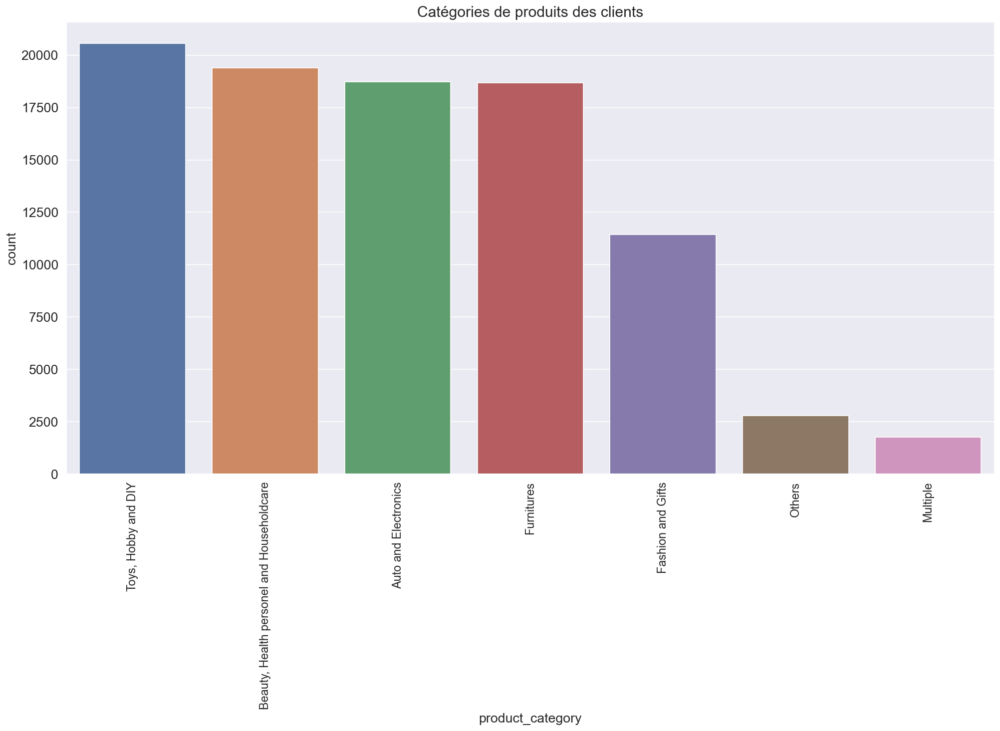

In [179]:
categ_cnt = pd.DataFrame(
    data=categories_customers['product_category'].value_counts())
categ_cnt.rename(
    columns={"product_category": "count"}, inplace=True)
fig = plt.figure(figsize=[20, 10], dpi=120)
sns.barplot(x=categ_cnt.index, y='count', data=categ_cnt)
plt.title('Catégories de produits des clients', fontsize=18)
plt.xlabel('product_category', fontsize=16)
plt.ylabel('count', fontsize=16)
plt.xticks(fontsize=14, rotation=90)
plt.yticks(fontsize=16)

In [180]:
data_df.set_index('customer_unique_id', inplace=True)

In [181]:
data_df['product_category'] = categories_customers['product_category']

In [182]:
data_df.head()

,nb_total_commandes,nb_total_produit,date_commande_plus_recente,nb_moyen_photo_par_commande,valeur totale,taille_commande_moyenne,max_type_payement,max_tranches_payement,nb_moyen_jours_livraison,notation_moyenne,nb_produits_premium,moyenne_frais/valeur_commande,récence,product_category
customer_unique_id,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,1,2018-05-10 10:56:27,1.0,129.90,141.90,0,1,6.0,5.0,0,0.084567,111,"Beauty, Health personel and Householdcare"
0000b849f77a49e4a4ce2b2a4ca5be3f,1,1,2018-05-07 11:11:27,1.0,18.90,27.19,0,0,3.0,4.0,0,0.304892,114,"Beauty, Health personel and Householdcare"
0000f46a3911fa3c0805444483337064,1,1,2017-03-10 21:05:03,3.0,69.00,86.22,0,1,25.0,3.0,0,0.199722,536,"Toys, Hobby and DIY"
0000f6ccb0745a6a4b88665a16c9f078,1,1,2017-10-12 20:29:41,5.0,25.99,43.62,0,1,20.0,4.0,0,0.404172,320,Auto and Electronics
0004aac84e0df4da2b147fca70cf8255,1,1,2017-11-14 19:45:42,3.0,180.00,196.89,0,1,13.0,5.0,1,0.085784,287,Auto and Electronics


In [183]:
data_df.shape

(93358, 14)

## Variable 'customer_state' 

In [184]:
data_orders_df.head()

,customer_id,customer_unique_id,nb_items,date_commande,id_produit,nb_photo_produit,prix_totale_commande,valeur_totale_frais_transport,nb_type_payement,nb_tranches,valeur_payement,nb_jours_délai_livraison,notation,customer_state,product_category,nb_produits_premium,frais/valeur_commande
0,fadbb3709178fc513abc1b2670aa1ad2,0000366f3b9a7992bf8c76cfdf3221e2,1,2018-05-10 10:56:27,{372645c7439f9661fbbacfd129aa92ec},1.0,129.90,12.00,0,1,141.90,6.0,5.0,SP,"Beauty, Health personel and Householdcare",0,0.084567
1,4cb282e167ae9234755102258dd52ee8,0000b849f77a49e4a4ce2b2a4ca5be3f,1,2018-05-07 11:11:27,{5099f7000472b634fea8304448d20825},1.0,18.90,8.29,0,0,27.19,3.0,4.0,SP,"Beauty, Health personel and Householdcare",0,0.304892
2,9b3932a6253894a02c1df9d19004239f,0000f46a3911fa3c0805444483337064,1,2017-03-10 21:05:03,{64b488de448a5324c4134ea39c28a34b},3.0,69.00,17.22,0,1,86.22,25.0,3.0,SP,"Toys, Hobby and DIY",0,0.199722
3,914991f0c02ef0843c0e7010c819d642,0000f6ccb0745a6a4b88665a16c9f078,1,2017-10-12 20:29:41,{2345a354a6f2033609bbf62bf5be9ef6},5.0,25.99,17.63,0,1,43.62,20.0,4.0,SP,Auto and Electronics,0,0.404172
4,47227568b10f5f58a524a75507e6992c,0004aac84e0df4da2b147fca70cf8255,1,2017-11-14 19:45:42,{c72e18b3fe2739b8d24ebf3102450f37},3.0,180.00,16.89,0,1,196.89,13.0,5.0,SP,Auto and Electronics,1,0.085784


In [185]:
data1 = data_orders_df.drop_duplicates(subset=['customer_unique_id'])
data1.shape

(93358, 17)

In [186]:
data1.head()

,customer_id,customer_unique_id,nb_items,date_commande,id_produit,nb_photo_produit,prix_totale_commande,valeur_totale_frais_transport,nb_type_payement,nb_tranches,valeur_payement,nb_jours_délai_livraison,notation,customer_state,product_category,nb_produits_premium,frais/valeur_commande
0,fadbb3709178fc513abc1b2670aa1ad2,0000366f3b9a7992bf8c76cfdf3221e2,1,2018-05-10 10:56:27,{372645c7439f9661fbbacfd129aa92ec},1.0,129.90,12.00,0,1,141.90,6.0,5.0,SP,"Beauty, Health personel and Householdcare",0,0.084567
1,4cb282e167ae9234755102258dd52ee8,0000b849f77a49e4a4ce2b2a4ca5be3f,1,2018-05-07 11:11:27,{5099f7000472b634fea8304448d20825},1.0,18.90,8.29,0,0,27.19,3.0,4.0,SP,"Beauty, Health personel and Householdcare",0,0.304892
2,9b3932a6253894a02c1df9d19004239f,0000f46a3911fa3c0805444483337064,1,2017-03-10 21:05:03,{64b488de448a5324c4134ea39c28a34b},3.0,69.00,17.22,0,1,86.22,25.0,3.0,SP,"Toys, Hobby and DIY",0,0.199722
3,914991f0c02ef0843c0e7010c819d642,0000f6ccb0745a6a4b88665a16c9f078,1,2017-10-12 20:29:41,{2345a354a6f2033609bbf62bf5be9ef6},5.0,25.99,17.63,0,1,43.62,20.0,4.0,SP,Auto and Electronics,0,0.404172
4,47227568b10f5f58a524a75507e6992c,0004aac84e0df4da2b147fca70cf8255,1,2017-11-14 19:45:42,{c72e18b3fe2739b8d24ebf3102450f37},3.0,180.00,16.89,0,1,196.89,13.0,5.0,SP,Auto and Electronics,1,0.085784


In [187]:
data1.set_index('customer_unique_id', inplace=True)

In [188]:
data_df['customer_state'] = data1['customer_state']
data_df['customer_state'].shape

(93358,)

In [189]:
data_df['customer_state'].value_counts()

SP    39267
RJ    11977
MG    10954
RS     5216
PR     4805
SC     3457
BA     3118
DF     2014
GO     1906
ES     1868
PE     1493
CE     1212
MT      896
PA      888
MS      691
MA      678
PB      501
PI      443
RN      441
AL      371
SE      317
TO      275
RO      236
AM      145
AC       83
AP       68
RR       38
Name: customer_state, dtype: int64

In [190]:
RJ_MG_RS_PR = ['RJ', 'MG', 'RS', 'PR']
others = ['AC', 'RO', 'AM', 'RR', 'AP', 'PA', 'TO', 'MA', 'PI', 'CE',
          'BA', 'PE', 'RN', 'PB', 'AL', 'SE', 'MT', 'GO', 'DF', 'MS', 'ES', 'SC']
data_df['customer_state'] = data_df['customer_state'].replace(
    RJ_MG_RS_PR, 'Rio de Janeiro, Belo Horizonte, Porto Alegre, Curitiba')
data_df['customer_state'] = data_df['customer_state'].replace(
    others, 'others')
data_df['customer_state'] = data_df['customer_state'].replace(
    'SP', 'São Paulo')
data_df['customer_state'].value_counts()

São Paulo                                                 39267
Rio de Janeiro, Belo Horizonte, Porto Alegre, Curitiba    32952
others                                                    21139
Name: customer_state, dtype: int64

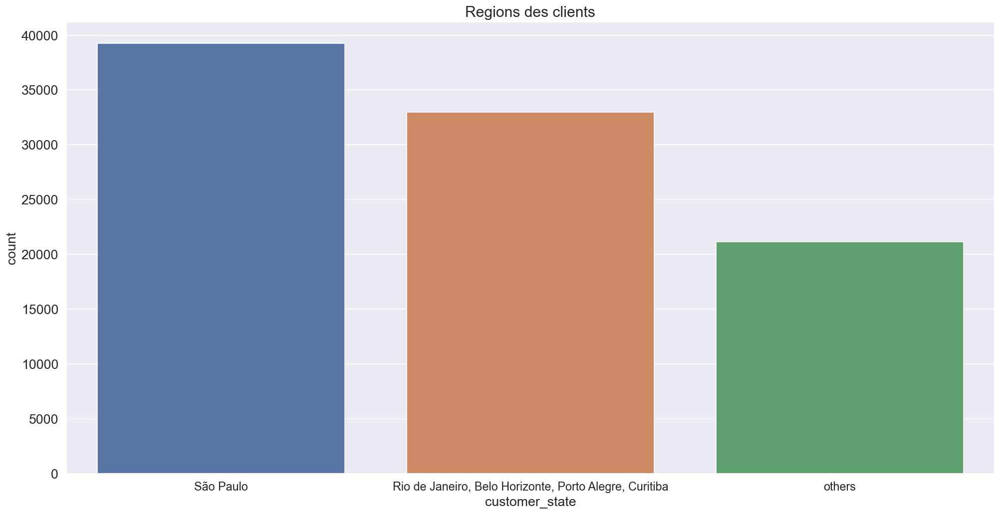

In [191]:
state_cnt = pd.DataFrame(
    data=data_df['customer_state'].value_counts())
state_cnt.rename(
    columns={"customer_state": "count"}, inplace=True)
fig = plt.figure(figsize=[20, 10], dpi=120);
sns.barplot(x=state_cnt.index, y='count', data=state_cnt)
plt.title('Regions des clients', fontsize=18)
plt.xlabel('customer_state', fontsize=16)
plt.ylabel('count', fontsize=16)
plt.xticks(fontsize=14, rotation=0)
plt.yticks(fontsize=16);

In [192]:
data_df.shape

(93358, 15)

In [193]:
data_df.head()

,nb_total_commandes,nb_total_produit,date_commande_plus_recente,nb_moyen_photo_par_commande,valeur totale,taille_commande_moyenne,max_type_payement,max_tranches_payement,nb_moyen_jours_livraison,notation_moyenne,nb_produits_premium,moyenne_frais/valeur_commande,récence,product_category,customer_state
customer_unique_id,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,1,2018-05-10 10:56:27,1.0,129.90,141.90,0,1,6.0,5.0,0,0.084567,111,"Beauty, Health personel and Householdcare",São Paulo
0000b849f77a49e4a4ce2b2a4ca5be3f,1,1,2018-05-07 11:11:27,1.0,18.90,27.19,0,0,3.0,4.0,0,0.304892,114,"Beauty, Health personel and Householdcare",São Paulo
0000f46a3911fa3c0805444483337064,1,1,2017-03-10 21:05:03,3.0,69.00,86.22,0,1,25.0,3.0,0,0.199722,536,"Toys, Hobby and DIY",São Paulo
0000f6ccb0745a6a4b88665a16c9f078,1,1,2017-10-12 20:29:41,5.0,25.99,43.62,0,1,20.0,4.0,0,0.404172,320,Auto and Electronics,São Paulo
0004aac84e0df4da2b147fca70cf8255,1,1,2017-11-14 19:45:42,3.0,180.00,196.89,0,1,13.0,5.0,1,0.085784,287,Auto and Electronics,São Paulo


In [194]:
data_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 93358 entries, 0000366f3b9a7992bf8c76cfdf3221e2 to ffffd2657e2aad2907e67c3e9daecbeb
Data columns (total 15 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   nb_total_commandes             93358 non-null  int64         
 1   nb_total_produit               93358 non-null  int64         
 2   date_commande_plus_recente     93358 non-null  datetime64[ns]
 3   nb_moyen_photo_par_commande    93358 non-null  float64       
 4   valeur totale                  93358 non-null  float64       
 5   taille_commande_moyenne        93358 non-null  float64       
 6   max_type_payement              93358 non-null  int32         
 7   max_tranches_payement          93358 non-null  int32         
 8   nb_moyen_jours_livraison       93358 non-null  float64       
 9   notation_moyenne               93358 non-null  float64       
 10  nb_produits_premium          

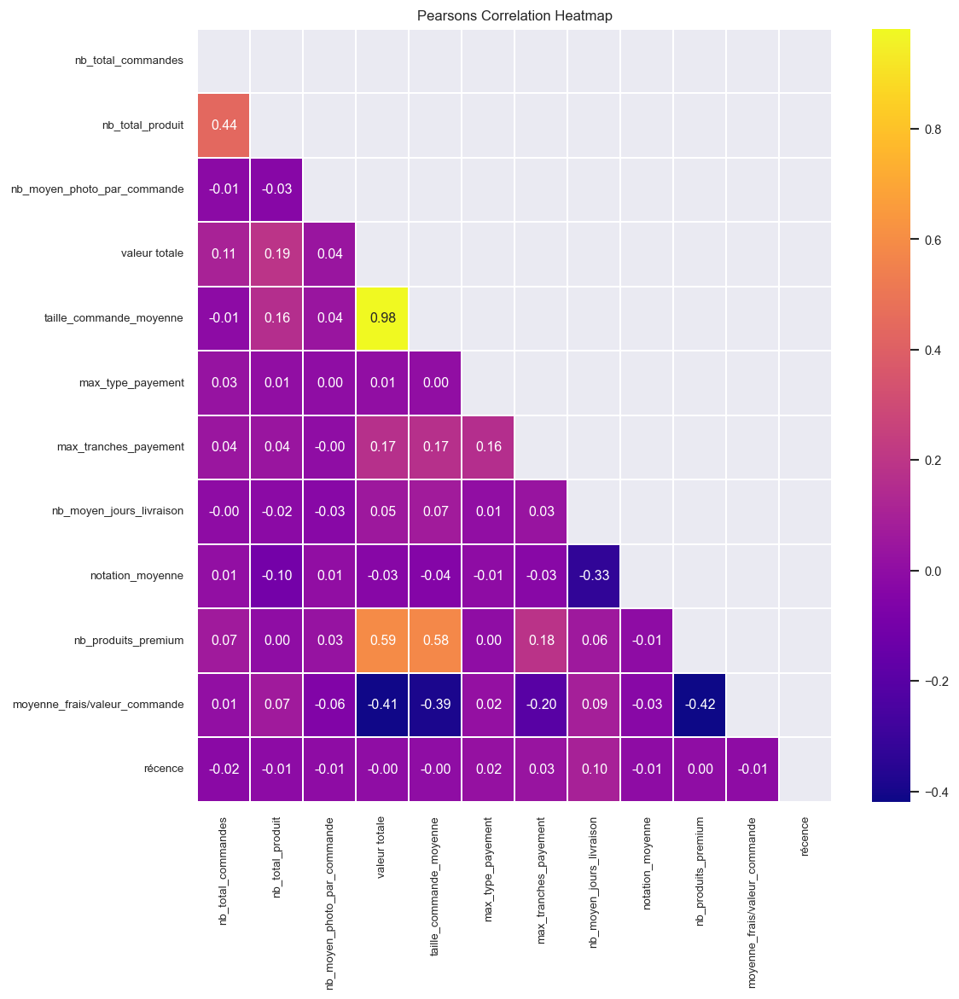

In [195]:
data_corr = data_df.drop(
    ['date_commande_plus_recente', 'product_category', 'customer_state'], axis=1)
sns.set(font_scale=0.8)
sns.set_style('darkgrid')
plt.figure(dpi=120, figsize=(10, 10))
mask = np.triu(np.ones_like(data_corr.corr(), dtype=bool))
sns.heatmap(data_corr.corr(), mask=mask, fmt=".2f",
            annot=True, lw=1, cmap='plasma')
plt.yticks(rotation=0, fontsize=8)
plt.xticks(rotation=90, fontsize=8)
plt.title('Pearsons Correlation Heatmap', fontsize=10)
plt.show()

In [196]:
data_df.to_csv("Data_customer_olist.csv", sep='\t')